# Problem Statement

An automobile parts manufacturing company has collected data on transactions for 3 years. They do not have any in-house data science team, thus they have hired you as their consultant. Your job is to use your data science skills to find the underlying buying patterns of the customers, provide the company with suitable insights about their customers, and recommend customized marketing strategies for different segments of customers. 

### General notes

- some of the EDA is found in the automatic EDA as there is no need to repeat for certain aspects of the analysis

### Importing the necessary Libraries

In [1]:

import numpy as np
import pandas as pd
from sklearn import metrics
import matplotlib.pyplot as plt
#import plotly.offline as py

%matplotlib inline
import seaborn as sns
from pylab import rcParams

In [241]:
##we visualise the time series and show the sales over time 
rcParams['figure.figsize'] = 15,8
rcParams["axes.labelsize"] = 17
rcParams["xtick.labelsize"] = 14
rcParams["ytick.labelsize"] = 14
rcParams["legend.fontsize"] = 10

## Loading the Dataset

In [2]:
import os 


###set file name to the current working directory where the full code notebook is so we can open the file 
file_name = f"""{os.getcwd()}/Sales_Data.xlsx"""



In [4]:
import xlrd
sales_data = pd.read_excel(file_name, sheet_name = "Data",  parse_dates=['ORDERDATE'])

### Data OverView

In [6]:
sales_data.head()

,ORDERNUMBER,QUANTITYORDERED,PRICEEACH,ORDERLINENUMBER,SALES,ORDERDATE,DAYS_SINCE_LASTORDER,STATUS,PRODUCTLINE,MSRP,PRODUCTCODE,CUSTOMERNAME,PHONE,ADDRESSLINE1,CITY,POSTALCODE,COUNTRY,CONTACTLASTNAME,CONTACTFIRSTNAME,DEALSIZE
0,10107,30,95.70,2,2871.00,2018-02-24,828,Shipped,Motorcycles,95,S10_1678,Land of Toys Inc.,2125557818,897 Long Airport Avenue,NYC,10022,USA,Yu,Kwai,Small
1,10121,34,81.35,5,2765.90,2018-05-07,757,Shipped,Motorcycles,95,S10_1678,Reims Collectables,26.47.1555,59 rue de l'Abbaye,Reims,51100,France,Henriot,Paul,Small
2,10134,41,94.74,2,3884.34,2018-07-01,703,Shipped,Motorcycles,95,S10_1678,Lyon Souveniers,+33 1 46 62 7555,27 rue du Colonel Pierre Avia,Paris,75508,France,Da Cunha,Daniel,Medium
3,10145,45,83.26,6,3746.70,2018-08-25,649,Shipped,Motorcycles,95,S10_1678,Toys4GrownUps.com,6265557265,78934 Hillside Dr.,Pasadena,90003,USA,Young,Julie,Medium
4,10168,36,96.66,1,3479.76,2018-10-28,586,Shipped,Motorcycles,95,S10_1678,Technics Stores Inc.,6505556809,9408 Furth Circle,Burlingame,94217,USA,Hirano,Juri,Medium


Column Name	Description
ORDERNUMBER - 	This column represents the unique identification number assigned to each order.

QUANTITYORDERED	- It indicates the number of items ordered in each order.

PRICEEACH	- This column specifies the price of each item in the order.

ORDERLINENUMBER	- It represents the line number of each item within an order.

SALES	- This column denotes the total sales amount for each order, which is calculated by multiplying the quantity ordered by the price of each item.

ORDERDATE	- It denotes the date on which the order was placed.

DAYS_SINCE_LASTORDER - 	This column represents the number of days that have passed since the last order for each customer. It can be used to analyze 
customer purchasing patterns.

STATUS - 	It indicates the status of the order, such as "Shipped," "In Process,"  "Cancelled," "Disputed," "On Hold," or "Resolved"

PRODUCTLINE	- This column specifies the product line categories to which each item belongs. 

MSRP - 	 It stands for Manufacturer's Suggested Retail Price and represents the suggested selling price for each item.

PRODUCTCODE	- This column represents the unique code assigned to each product.

CUSTOMERNAME - 	It denotes the name of the customer who placed the order.

PHONE	- This column contains the contact phone number for the customer.

ADDRESSLINE1 - 	It represents the first line of the customer's address.

CITY	- This column specifies the city where the customer is located.

POSTALCODE	-  It denotes the postal code or ZIP code associated with the customer's address.

COUNTRY	 - This column indicates the country where the customer is located.

CONTACTLASTNAME	- It represents the last name of the contact person associated with the customer.

CONTACTFIRSTNAME - 	This column denotes the first name of the contact person associated with the customer.

DEALSIZE	- It indicates the size of the deal or order, which are the categories "Small," "Medium," or "Large."

In [7]:
#a print out of the shape of the dataset
print(f"""Your data has {sales_data.shape[0]} rows and {sales_data.shape[1]}  columns.""")

Your data has 2747 rows and 20  columns.


In [8]:
#information on the dataset 
sales_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2747 entries, 0 to 2746
Data columns (total 20 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   ORDERNUMBER           2747 non-null   int64         
 1   QUANTITYORDERED       2747 non-null   int64         
 2   PRICEEACH             2747 non-null   float64       
 3   ORDERLINENUMBER       2747 non-null   int64         
 4   SALES                 2747 non-null   float64       
 5   ORDERDATE             2747 non-null   datetime64[ns]
 6   DAYS_SINCE_LASTORDER  2747 non-null   int64         
 7   STATUS                2747 non-null   object        
 8   PRODUCTLINE           2747 non-null   object        
 9   MSRP                  2747 non-null   int64         
 10  PRODUCTCODE           2747 non-null   object        
 11  CUSTOMERNAME          2747 non-null   object        
 12  PHONE                 2747 non-null   object        
 13  ADDRESSLINE1      

In [222]:
from IPython.display import HTML 
#description of the dataset statistics

sales_data.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
ORDERNUMBER,2747.0,10259.761558,91.877521,10100.000000,10181.000000,10264.000000,10334.500000,10425.000000
QUANTITYORDERED,2747.0,35.103021,9.762135,6.000000,27.000000,35.000000,43.000000,97.000000
PRICEEACH,2747.0,101.098951,42.042548,26.880000,68.745000,95.550000,127.100000,252.870000
ORDERLINENUMBER,2747.0,6.491081,4.230544,1.000000,3.000000,6.000000,9.000000,18.000000
SALES,2747.0,3553.047583,1838.953901,482.130000,2204.350000,3184.800000,4503.095000,14082.800000
DAYS_SINCE_LASTORDER,2747.0,1757.085912,819.280576,42.000000,1077.000000,1761.000000,2436.500000,3562.000000
MSRP,2747.0,100.691664,40.114802,33.000000,68.000000,99.000000,124.000000,214.000000
MONTH_NUM,2747.0,7.083364,3.641826,1.000000,4.000000,8.000000,11.000000,12.000000
YEAR,2747.0,2018.822352,0.696288,2018.000000,2018.000000,2019.000000,2019.000000,2020.000000
WEEK,2747.0,28.948671,15.709533,1.000000,14.000000,32.000000,45.000000,51.000000


In [231]:
display(HTML(sales_data.describe().transpose().to_html()))

,count,mean,std,min,25%,50%,75%,max
ORDERNUMBER,2747.0,10259.761558,91.877521,10100.000000,10181.000000,10264.000000,10334.500000,10425.000000
QUANTITYORDERED,2747.0,35.103021,9.762135,6.000000,27.000000,35.000000,43.000000,97.000000
PRICEEACH,2747.0,101.098951,42.042548,26.880000,68.745000,95.550000,127.100000,252.870000
ORDERLINENUMBER,2747.0,6.491081,4.230544,1.000000,3.000000,6.000000,9.000000,18.000000
SALES,2747.0,3553.047583,1838.953901,482.130000,2204.350000,3184.800000,4503.095000,14082.800000
DAYS_SINCE_LASTORDER,2747.0,1757.085912,819.280576,42.000000,1077.000000,1761.000000,2436.500000,3562.000000
MSRP,2747.0,100.691664,40.114802,33.000000,68.000000,99.000000,124.000000,214.000000
MONTH_NUM,2747.0,7.083364,3.641826,1.000000,4.000000,8.000000,11.000000,12.000000
YEAR,2747.0,2018.822352,0.696288,2018.000000,2018.000000,2019.000000,2019.000000,2020.000000
WEEK,2747.0,28.948671,15.709533,1.000000,14.000000,32.000000,45.000000,51.000000


### Pre-processing our data

In [10]:
#function that prints out whether there are missing values in the data or not 
if (sales_data.isnull().sum())[0] > 0 :
  
    print(f"""There are {(sales_data.isnull().sum())[0]} missing values and you have to interpolate""")
else:
    print("There are no mising values in the dataset")

There are no mising values in the dataset


In [12]:
"""
We write code to identify duplicates in the ordernumber column as ti makes sense for every other column to have an order number

"""

duplicates = sales_data[sales_data["ORDERNUMBER"].duplicated()]

if not duplicates.empty:
    print("There are some repeated values for some orders in the ordernumber column, so it is an itemised list per invoice:")
    print(duplicates)
else:
    print("No duplicates found in the date column no need to average")

There are some repeated values for some orders in the ordernumber column, so it is an itemised list per invoice:
      ORDERNUMBER  QUANTITYORDERED  PRICEEACH  ORDERLINENUMBER    SALES  \
50          10107               39      99.91                5  3896.49   
52          10134               27     122.51                5  3307.77   
53          10145               37     140.35                9  5192.95   
54          10168               27     135.59                4  3660.93   
55          10180               42     111.80               12  4695.60   
...           ...              ...        ...              ...      ...   
2742        10350               20     112.22               15  2244.40   
2743        10373               29     137.19                1  3978.51   
2744        10386               43     125.99                4  5417.57   
2745        10397               34      62.24                1  2116.16   
2746        10414               47      65.52                9

In [13]:
##there are a total of 298 unique orders in the data 
print(f"""There are a total of {len(sales_data["ORDERNUMBER"].unique())} unique orders in the data""")

There are a total of 298 unique orders in the data


In [14]:
sales_data["ORDERNUMBER"][sales_data['ORDERNUMBER'].duplicated(keep=False)]

0       10107
1       10121
2       10134
3       10145
4       10168
        ...  
2742    10350
2743    10373
2744    10386
2745    10397
2746    10414
Name: ORDERNUMBER, Length: 2731, dtype: int64

In [15]:
## we can see that the sales data has multiple rows per order number and clients order multiple items per order
sales_data[sales_data['ORDERNUMBER'] == 10107]

,ORDERNUMBER,QUANTITYORDERED,PRICEEACH,ORDERLINENUMBER,SALES,ORDERDATE,DAYS_SINCE_LASTORDER,STATUS,PRODUCTLINE,MSRP,PRODUCTCODE,CUSTOMERNAME,PHONE,ADDRESSLINE1,CITY,POSTALCODE,COUNTRY,CONTACTLASTNAME,CONTACTFIRSTNAME,DEALSIZE
0,10107,30,95.70,2,2871.00,2018-02-24,828,Shipped,Motorcycles,95,S10_1678,Land of Toys Inc.,2125557818,897 Long Airport Avenue,NYC,10022,USA,Yu,Kwai,Small
50,10107,39,99.91,5,3896.49,2018-02-24,878,Shipped,Motorcycles,118,S10_2016,Land of Toys Inc.,2125557818,897 Long Airport Avenue,NYC,10022,USA,Yu,Kwai,Medium
74,10107,27,224.65,4,6065.55,2018-02-24,902,Shipped,Motorcycles,193,S10_4698,Land of Toys Inc.,2125557818,897 Long Airport Avenue,NYC,10022,USA,Yu,Kwai,Medium
226,10107,21,144.60,1,3036.60,2018-02-24,1054,Shipped,Motorcycles,150,S12_2823,Land of Toys Inc.,2125557818,897 Long Airport Avenue,NYC,10022,USA,Yu,Kwai,Medium
773,10107,29,70.87,6,2055.23,2018-02-24,1601,Shipped,Motorcycles,60,S18_2625,Land of Toys Inc.,2125557818,897 Long Airport Avenue,NYC,10022,USA,Yu,Kwai,Small
1415,10107,25,113.83,3,2845.75,2018-02-24,2243,Shipped,Motorcycles,112,S24_1578,Land of Toys Inc.,2125557818,897 Long Airport Avenue,NYC,10022,USA,Yu,Kwai,Small
1510,10107,38,83.03,7,3155.14,2018-02-24,2338,Shipped,Motorcycles,76,S24_2000,Land of Toys Inc.,2125557818,897 Long Airport Avenue,NYC,10022,USA,Yu,Kwai,Medium
2104,10107,20,92.90,8,1858.00,2018-02-24,2932,Shipped,Motorcycles,99,S32_1374,Land of Toys Inc.,2125557818,897 Long Airport Avenue,NYC,10022,USA,Yu,Kwai,Small


#### Observations

- we can see that the sales data has multiple rows per order number and clients order multiple items per order

### Exploratory Data Analysis

  0%|          | 0/2488 [00:00<?, ?it/s]

/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/dataprep/e

DataPrep Report
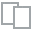
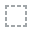
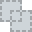
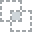
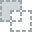
...
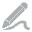
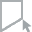
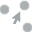
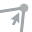
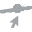

In [16]:
from dataprep.eda import create_report

#we use the data prep create report function to create an initial EDA report on our data to give us an overall idea of what is going on 

create_report(sales_data)

### Observations

- The data runs from 2018-01-06 00:00:00 to 2020-05-31 00:00:00

There are a few dimensions we can organise the analysis along:

- Uni-variate analysis of the columns in the data 
- Relationships between sales and the other variables 
- Along the dimension of time i.e. Monthly, quarterly, yearly sales 



#### Over view of data

In [191]:
sales_data.head()

,ORDERNUMBER,QUANTITYORDERED,PRICEEACH,ORDERLINENUMBER,SALES,ORDERDATE,DAYS_SINCE_LASTORDER,STATUS,PRODUCTLINE,MSRP,...,CONTACTFIRSTNAME,DEALSIZE,MONTH,MONTH_NUM,YEAR,WEEK,QUARTER,DISCOUNT,PCT_DISCOUNT,Discount
0,10107,30,95.70,2,2871.00,2018-02-24,828,Shipped,Motorcycles,95,...,Kwai,Small,February,2,2018,8,1,-0.70,0.007368,Discuont
1,10121,34,81.35,5,2765.90,2018-05-07,757,Shipped,Motorcycles,95,...,Paul,Small,May,5,2018,19,2,13.65,-0.143684,Over MSRP
2,10134,41,94.74,2,3884.34,2018-07-01,703,Shipped,Motorcycles,95,...,Daniel,Medium,July,7,2018,26,3,0.26,-0.002737,Over MSRP
3,10145,45,83.26,6,3746.70,2018-08-25,649,Shipped,Motorcycles,95,...,Julie,Medium,August,8,2018,34,3,11.74,-0.123579,Over MSRP
4,10168,36,96.66,1,3479.76,2018-10-28,586,Shipped,Motorcycles,95,...,Juri,Medium,October,10,2018,43,4,-1.66,0.017474,Discuont


In [192]:
### number of unique orders
f""" There are {len(sales_data.ORDERNUMBER.unique())} unique orders"""
 

298

In [214]:
### number of unique products
f""" There are {len(sales_data.PRODUCTLINE.unique())} unique product lines"""

' There are 7 unique product lines'

In [196]:
### number of unique customers
f""" There are {len(sales_data.CUSTOMERNAME.unique())} unique customers"""


' There are 89 unique customers'

In [202]:
### Total sales
f""" We sold {sum(sales_data.SALES)} in products in total"""

' We sold 9760221.710000016 in products in total'

### Trend of sales by time

/var/folders/nc/l228b13146bf52hql4t835lc0000gn/T/ipykernel_27461/1617235841.py:4: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  sales_data["WEEK"] = sales_data.ORDERDATE.dt.week


,ORDERDATE,SALES
0,2018-01-06,12133.25
1,2018-01-09,11432.34
2,2018-01-10,6864.05
3,2018-01-29,54702.00
4,2018-01-31,44621.96


#### UnI-VARIATE ANALYSIS

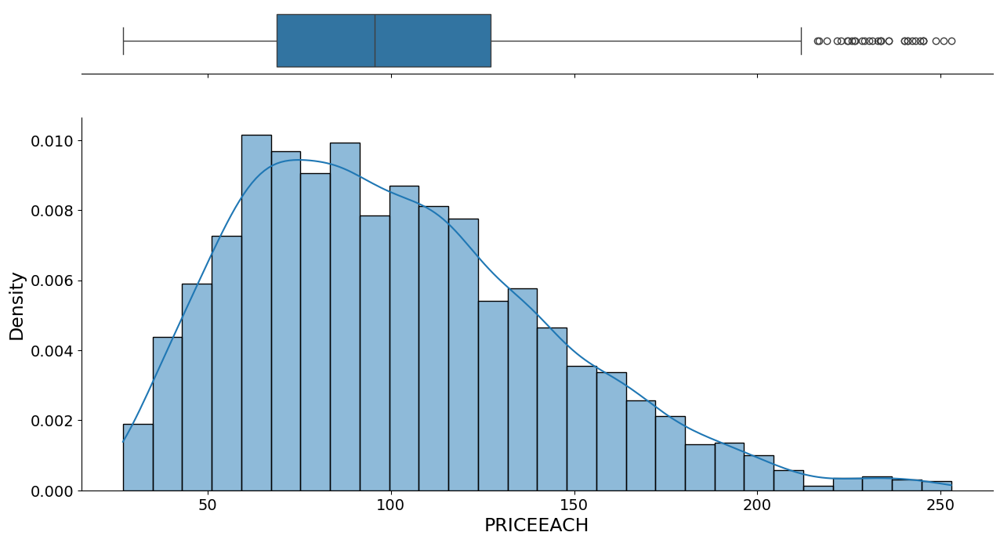

In [249]:
#boxplot of the monthly sales
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)})

sns.boxplot(x = sales_data.PRICEEACH, ax=ax_box)
sns.histplot(x=sales_data.PRICEEACH, kde=True, stat='density', ax=ax_hist)
ax_box.set(yticks=[])
sns.despine(ax=ax_hist)
sns.despine(ax=ax_box, left=True)
#plt.title("Monthly Boxplot of Price")
plt.grid(False);

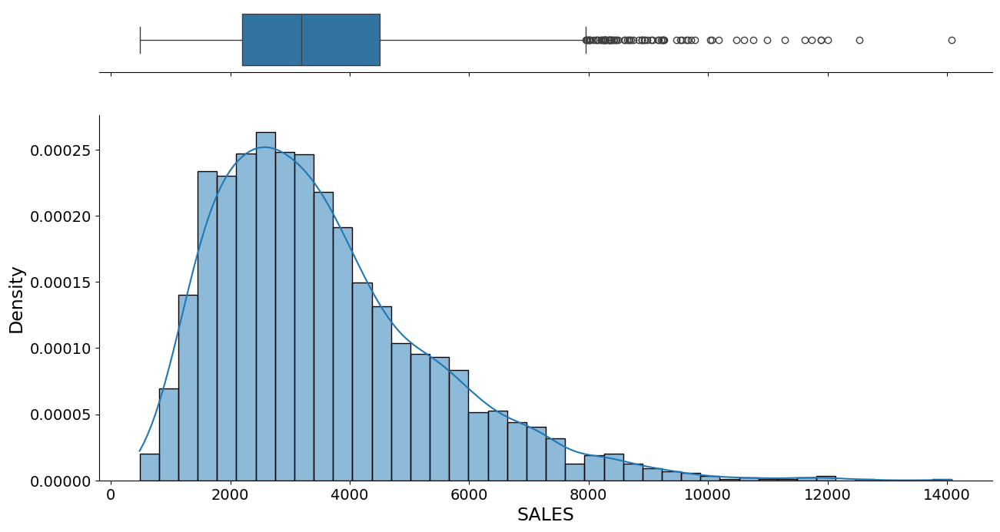

In [250]:
#boxplot of the monthly sales
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)})

sns.boxplot(x = sales_data.SALES, ax=ax_box)
sns.histplot(x=sales_data.SALES, kde=True, stat='density', ax=ax_hist)
ax_box.set(yticks=[])
sns.despine(ax=ax_hist)
sns.despine(ax=ax_box, left=True)


#plt.title("Monthly Boxplot of Sales")
plt.grid(False);

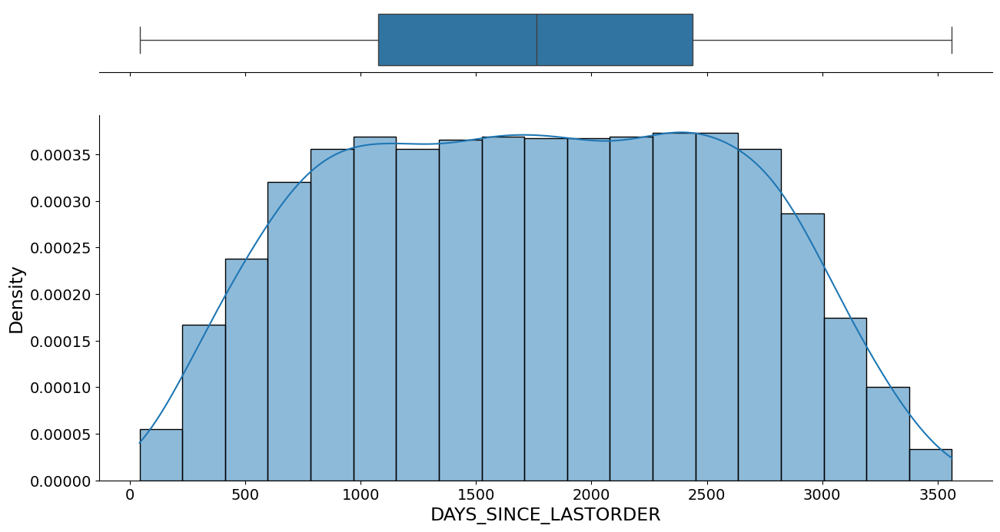

In [251]:
#boxplot of the monthly sales
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)})

sns.boxplot(x = sales_data.DAYS_SINCE_LASTORDER, ax=ax_box)
sns.histplot(x=sales_data.DAYS_SINCE_LASTORDER, kde=True, stat='density', ax=ax_hist)
ax_box.set(yticks=[])
sns.despine(ax=ax_hist)
sns.despine(ax=ax_box, left=True)


#plt.title("Monthly Boxplot of Days Since the Last Order")
plt.grid(False);

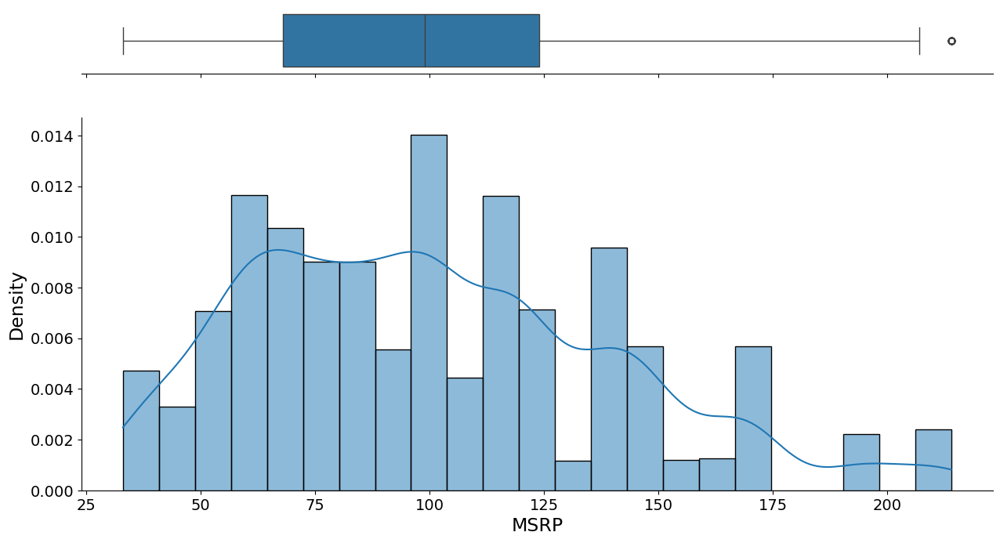

In [252]:
#boxplot of the monthly sales
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)})

sns.boxplot(x = sales_data.MSRP, ax=ax_box)
sns.histplot(x=sales_data.MSRP, kde=True, stat='density', ax=ax_hist)
ax_box.set(yticks=[])
sns.despine(ax=ax_hist)
sns.despine(ax=ax_box, left=True)



#plt.title("Monthly Boxplot of Manufacturer Recommended Price")
plt.grid(False);

#### Observations

- QUANTITYORDERED: The quantity ordered shows a right-skewed distribution, meaning most orders are for fewer items, with fewer large-quantity orders.
- PRICEEACH: The price for each item also appears right-skewed, indicating most items are sold at a lower price point, with a few items sold at higher prices.
- SALES: The total sales amount per order is right-skewed as well, which is consistent with the quantity and price distributions. Most sales amounts are lower, with fewer high-value sales.
- DAYS_SINCE_LASTORDER: This metric shows a fairly uniform distribution across the range, with slight peaks, suggesting that repeat purchases occur at various intervals.
- MSRP: The manufacturer's suggested retail price seems to have multiple peaks, which could indicate different price tiers for products.


### Prepare the data and add new columns

In [78]:
sales_data.columns

Index(['ORDERNUMBER', 'QUANTITYORDERED', 'PRICEEACH', 'ORDERLINENUMBER',
       'SALES', 'ORDERDATE', 'DAYS_SINCE_LASTORDER', 'STATUS', 'PRODUCTLINE',
       'MSRP', 'PRODUCTCODE', 'CUSTOMERNAME', 'PHONE', 'ADDRESSLINE1', 'CITY',
       'POSTALCODE', 'COUNTRY', 'CONTACTLASTNAME', 'CONTACTFIRSTNAME',
       'DEALSIZE'],
      dtype='object')

In [103]:
sales_data.head()

,ORDERNUMBER,QUANTITYORDERED,PRICEEACH,ORDERLINENUMBER,SALES,ORDERDATE,DAYS_SINCE_LASTORDER,STATUS,PRODUCTLINE,MSRP,...,PHONE,ADDRESSLINE1,CITY,POSTALCODE,COUNTRY,CONTACTLASTNAME,CONTACTFIRSTNAME,DEALSIZE,DISCOUNT,PCT_DISCOUNT
0,10107,30,95.70,2,2871.00,2018-02-24,828,Shipped,Motorcycles,95,...,2125557818,897 Long Airport Avenue,NYC,10022,USA,Yu,Kwai,Small,-0.70,0.007368
1,10121,34,81.35,5,2765.90,2018-05-07,757,Shipped,Motorcycles,95,...,26.47.1555,59 rue de l'Abbaye,Reims,51100,France,Henriot,Paul,Small,13.65,-0.143684
2,10134,41,94.74,2,3884.34,2018-07-01,703,Shipped,Motorcycles,95,...,+33 1 46 62 7555,27 rue du Colonel Pierre Avia,Paris,75508,France,Da Cunha,Daniel,Medium,0.26,-0.002737
3,10145,45,83.26,6,3746.70,2018-08-25,649,Shipped,Motorcycles,95,...,6265557265,78934 Hillside Dr.,Pasadena,90003,USA,Young,Julie,Medium,11.74,-0.123579
4,10168,36,96.66,1,3479.76,2018-10-28,586,Shipped,Motorcycles,95,...,6505556809,9408 Furth Circle,Burlingame,94217,USA,Hirano,Juri,Medium,-1.66,0.017474


In [150]:
sales_data.columns

Index(['ORDERNUMBER', 'QUANTITYORDERED', 'PRICEEACH', 'ORDERLINENUMBER',
       'SALES', 'ORDERDATE', 'DAYS_SINCE_LASTORDER', 'STATUS', 'PRODUCTLINE',
       'MSRP', 'PRODUCTCODE', 'CUSTOMERNAME', 'PHONE', 'ADDRESSLINE1', 'CITY',
       'POSTALCODE', 'COUNTRY', 'CONTACTLASTNAME', 'CONTACTFIRSTNAME',
       'DEALSIZE', 'MONTH', 'MONTH_NUM', 'YEAR', 'WEEK', 'QUARTER', 'DISCOUNT',
       'PCT_DISCOUNT', 'Discount'],
      dtype='object')

In [167]:
sales_data.filter(items =sales_data.columns ).query('Discount == "MSRP"')

,ORDERNUMBER,QUANTITYORDERED,PRICEEACH,ORDERLINENUMBER,SALES,ORDERDATE,DAYS_SINCE_LASTORDER,STATUS,PRODUCTLINE,MSRP,...,CONTACTFIRSTNAME,DEALSIZE,MONTH,MONTH_NUM,YEAR,WEEK,QUARTER,DISCOUNT,PCT_DISCOUNT,Discount
565,10302,43,170.0,1,7310.0,2018-10-06,1169,Shipped,Vintage Cars,170,...,Elizabeth,Large,October,10,2018,40,4,0.0,0.0,MSRP
568,10344,45,170.0,1,7650.0,2019-11-25,757,Shipped,Vintage Cars,170,...,Laurence,Large,November,11,2019,48,4,0.0,0.0,MSRP
1740,10203,21,37.0,2,777.0,2018-12-02,2287,Shipped,Classic Cars,37,...,Diego,Small,December,12,2018,48,4,0.0,0.0,MSRP


In [164]:
discount_only = sales_data.filter(items =sales_data.columns ).query('Discount != "MSRP"')

In [546]:
#Looking at the pricing of the different products

source = sales_data

alt.Chart(source).mark_boxplot().encode(
    alt.X("PRODUCTLINE:N"),
    alt.Y("SALES:Q").scale(zero=False),
    alt.Color("PRODUCTLINE:N").legend(None),
).properties(
    width='container',
    height=500
).configure_axis(
    labelFontSize=17,
    titleFontSize=17
).configure_title(fontSize= 17)

alt.Chart(...)

### Observation
SALES by PRODUCTLINE: 
Different product lines show different sales distributions. Some product lines have a wider range of sales values, indicating that they may have more variability in the number of items sold or in their prices. This could suggest that certain product lines have more premium options or bulk sales.


In [140]:
sales_data.columns

Index(['ORDERNUMBER', 'QUANTITYORDERED', 'PRICEEACH', 'ORDERLINENUMBER',
       'SALES', 'ORDERDATE', 'DAYS_SINCE_LASTORDER', 'STATUS', 'PRODUCTLINE',
       'MSRP', 'PRODUCTCODE', 'CUSTOMERNAME', 'PHONE', 'ADDRESSLINE1', 'CITY',
       'POSTALCODE', 'COUNTRY', 'CONTACTLASTNAME', 'CONTACTFIRSTNAME',
       'DEALSIZE', 'MONTH', 'MONTH_NUM', 'YEAR', 'WEEK', 'QUARTER', 'DISCOUNT',
       'PCT_DISCOUNT'],
      dtype='object')

In [543]:
#Looking at the pricing of the different products

source = sales_data

alt.Chart(source).mark_boxplot().encode(
    alt.X("PRODUCTLINE:N"),
    alt.Y("PRICEEACH:Q").scale(zero=False),
    alt.Color("PRODUCTLINE:N").legend(None),
).properties(
    width='container',
    height=500
).configure_axis(
    labelFontSize=17,
    titleFontSize=17
).configure_title(fontSize= 17)

alt.Chart(...)

### Observation
SALES by PRICEEACH: 
Different product lines show different Price distributions. Some product lines have a wider range of price values, indicating that they may have more variability in their prices. This could suggest that certain product lines have more premium options or bulk sales.


In [548]:

source = sales_data

alt.Chart(source).mark_boxplot().encode(
    alt.X("COUNTRY:N"),
    alt.Y("SALES:Q").scale(zero=False),
    #alt.Color("COUNTRY:N").legend(None),
).properties(
    width='container',
    height=500
).configure_axis(
    labelFontSize=17,
    titleFontSize=17
).configure_title(fontSize= 17)

alt.Chart(...)

### Observation
SALES by COUNTRY:
 The sales by country show significant variation. Some countries have a higher median sales value, which could indicate a stronger market or a preference for more expensive products. This information can be vital for tailoring marketing strategies to different regions.


In [260]:
sales_data.head()

,ORDERNUMBER,QUANTITYORDERED,PRICEEACH,ORDERLINENUMBER,SALES,ORDERDATE,DAYS_SINCE_LASTORDER,STATUS,PRODUCTLINE,MSRP,...,DEALSIZE,MONTH,MONTH_NUM,YEAR,WEEK,QUARTER,DISCOUNT,PCT_DISCOUNT,Discount,MONTH_NAME
0,10107,30,95.70,2,2871.00,2018-02-24,828,Shipped,Motorcycles,95,...,Small,February,2,2018,8,1,-0.70,0.007368,Discuont,February
1,10121,34,81.35,5,2765.90,2018-05-07,757,Shipped,Motorcycles,95,...,Small,May,5,2018,19,2,13.65,-0.143684,Over MSRP,May
2,10134,41,94.74,2,3884.34,2018-07-01,703,Shipped,Motorcycles,95,...,Medium,July,7,2018,26,3,0.26,-0.002737,Over MSRP,July
3,10145,45,83.26,6,3746.70,2018-08-25,649,Shipped,Motorcycles,95,...,Medium,August,8,2018,34,3,11.74,-0.123579,Over MSRP,August
4,10168,36,96.66,1,3479.76,2018-10-28,586,Shipped,Motorcycles,95,...,Medium,October,10,2018,43,4,-1.66,0.017474,Discuont,October


In [458]:
sales_data_country = sales_data.groupby('COUNTRY', as_index=False).agg(
            total_sales = ("SALES", "sum"),
            total_customers = ("CUSTOMERNAME", "nunique")
       
            


).sort_values(by=["total_sales"], ascending = False)


sales_data_country["count_cumsum"] = sales_data_country["total_sales"].cumsum()
sales_data_country["cumpercentage"] = sales_data_country["count_cumsum"]/(sales_data_country["total_sales"].sum())
sales_data_country.head()

,COUNTRY,total_sales,total_customers,count_cumsum,cumpercentage
18,USA,3355575.69,32,3355575.69,0.343801
14,Spain,1215686.92,5,4571262.61,0.468356
6,France,1110916.52,12,5682179.13,0.582177
0,Australia,630623.10,5,6312802.23,0.646789
17,UK,478880.46,5,6791682.69,0.695853


In [433]:
###Creating the Pareto chart
sales_data_country = sales_data.groupby('COUNTRY', as_index=False)["SALES"].sum().sort_values(by=["SALES"], ascending = False)
sales_data_country["count_cumsum"] = sales_data_country["SALES"].cumsum()
sales_data_country["cumpercentage"] = sales_data_country["count_cumsum"]/(sales_data_country["SALES"].sum())
sales_data_country.head()

,COUNTRY,SALES,count_cumsum,cumpercentage
18,USA,3355575.69,3355575.69,0.343801
14,Spain,1215686.92,4571262.61,0.468356
6,France,1110916.52,5682179.13,0.582177
0,Australia,630623.10,6312802.23,0.646789
17,UK,478880.46,6791682.69,0.695853


- We make 82% of our sales from the top 9 countries 

In [378]:
countries_to_analyse = sales_data_country.filter(items=sales_data_country.columns).query('cumpercentage < 0.83')["COUNTRY"].to_list()

In [465]:
####Creating layered alt chart 
## we create the base for the chart##
base = alt.Chart(sales_data_country).encode(
    x = alt.X("COUNTRY:O",sort=countries_to_analyse, axis=alt.Axis(labelFontSize=17,
    titleFontSize=17)),
).properties (
width = 'container',
height = 500
)


# Create the bars with length encoded along the Y axis 
bars = base.mark_bar().encode(
    y = alt.Y("total_sales:Q",  axis=alt.Axis(labelFontSize=17,
    titleFontSize=17)),
    color=alt.condition(
        # If  the sales are greater than the UK highlight the data ,
        alt.datum.total_sales >= 478880.46,  
        # which sets the bar orange.
        alt.value('orange'),     
        # And if it's not true it sets the bar light greay .
        alt.value('lightgrey')   
    )
).properties (
width = 'container',
height = 500
)
# Create the line chart with length encoded along the Y axis
line = base.mark_line(
                       strokeWidth= 1.5,
                       color = "#cb4154" 
).encode(
    y=alt.Y('cumpercentage:Q',
             title='Cumulative Sales',
             axis=alt.Axis(format=".0%", labelFontSize=17,
    titleFontSize=17)  ),
    text = alt.Text('cumpercentage:Q')
)


# Mark the percentage values on the line with Circle marks
points = base.mark_circle(
              strokeWidth= 3,
              color = "#cb4154" 
).encode(
         y=alt.Y('cumpercentage:Q', axis=None),
)
# Mark the bar marks with the value text
bar_text = bars.mark_text(
    align='left',
    baseline='middle',
    dx=-10,  #the dx and dy can be manipulated to position text
    dy = -10, #relative to the bar
    fontSize=12,
).encode(
    y= alt.Y('total_sales:Q', axis=None),
    # we'll use the percentage as the text
    text=alt.Text('total_customers:Q',),
    color= alt.value("#000000")
)
# Mark the Circle marks with the value text
point_text = points.mark_text(
    align='left',
    baseline='middle',
    dx=-10, 
    fontSize=12,
    dy = -10,
).encode(
    y= alt.Y('cumpercentage:Q', axis=None),
    # we'll use the percentage as the text
    text=alt.Text('cumpercentage:Q', format="0.0%"),
    color= alt.value("#cb4154")
)

# Layer all the elements together 
(bars + bar_text +  line + points + point_text).resolve_scale(
    y = 'independent'
)

alt.LayerChart(...)

### Observations
-  The USA has most of our customers and 32% of the clients make up for 34% of our total sales over the duration. The rate of return per client in the US is on average less than one percent but this could be due to a mix of client types. This is our most valuable market 
- We make 82% of our sales form the top 9 countries. We make 70% of our total sales from the top 5 countries. Most of our sales are driven by a few  
- We can see that Spain has the most valuable customers in terms of return as 5 clients give us 13% of our sales making them our most valuable clients in terms of return per client. These are most likely clients buying high margin items and luxury goods and more of a niche market



In [466]:
sales_data_country.head()

,COUNTRY,total_sales,total_customers,count_cumsum,cumpercentage
18,USA,3355575.69,32,3355575.69,0.343801
14,Spain,1215686.92,5,4571262.61,0.468356
6,France,1110916.52,12,5682179.13,0.582177
0,Australia,630623.10,5,6312802.23,0.646789
17,UK,478880.46,5,6791682.69,0.695853


In [468]:
sales_data_country["SALES_RATIO"] = sales_data_country["total_sales"]/sales_data_country["total_customers"]
sales_data_country.head()

,COUNTRY,total_sales,total_customers,count_cumsum,cumpercentage,SALES_RATIO
18,USA,3355575.69,32,3355575.69,0.343801,104861.740312
14,Spain,1215686.92,5,4571262.61,0.468356,243137.384000
6,France,1110916.52,12,5682179.13,0.582177,92576.376667
0,Australia,630623.10,5,6312802.23,0.646789,126124.620000
17,UK,478880.46,5,6791682.69,0.695853,95776.092000


In [470]:
base = alt.Chart(sales_ratios_new).encode(
    x = alt.X("COUNTRY:O",sort=countries_to_analyse, axis=alt.Axis(labelFontSize=17,
    titleFontSize=17)),
).properties (
width = 'container',
height = 500
)


# Create the bars with length encoded along the Y axis 
bars = base.mark_bar().encode(
    y = alt.Y("SALES_RATIO:Q",  axis=alt.Axis(labelFontSize=17,
    titleFontSize=17)),
    
).properties (
width = 'container',
height = 500
)

# Layer all the elements together 
(bars ).resolve_scale(
    y = 'independent'
)

alt.Chart(...)

### Observations

- We can see that the return per client is highest in Spain and it is almost 2 times that of the United States
- Some of the countries with lower total sales (or number of orders) have a higher return per sale on average than the United States probably indicating that we have probably attracted higher networth individuals who buy luxury items in this market

In [471]:
sales_data.head()

,ORDERNUMBER,QUANTITYORDERED,PRICEEACH,ORDERLINENUMBER,SALES,ORDERDATE,DAYS_SINCE_LASTORDER,STATUS,PRODUCTLINE,MSRP,...,DEALSIZE,MONTH,MONTH_NUM,YEAR,WEEK,QUARTER,DISCOUNT,PCT_DISCOUNT,Discount,MONTH_NAME
0,10107,30,95.70,2,2871.00,2018-02-24,828,Shipped,Motorcycles,95,...,Small,February,2,2018,8,1,-0.70,0.007368,Discuont,February
1,10121,34,81.35,5,2765.90,2018-05-07,757,Shipped,Motorcycles,95,...,Small,May,5,2018,19,2,13.65,-0.143684,Over MSRP,May
2,10134,41,94.74,2,3884.34,2018-07-01,703,Shipped,Motorcycles,95,...,Medium,July,7,2018,26,3,0.26,-0.002737,Over MSRP,July
3,10145,45,83.26,6,3746.70,2018-08-25,649,Shipped,Motorcycles,95,...,Medium,August,8,2018,34,3,11.74,-0.123579,Over MSRP,August
4,10168,36,96.66,1,3479.76,2018-10-28,586,Shipped,Motorcycles,95,...,Medium,October,10,2018,43,4,-1.66,0.017474,Discuont,October


In [513]:
sales_by_customers= sales_data.groupby(["CUSTOMERNAME"], as_index = False).agg(
    country_of_origin = ("COUNTRY","first"),
    total_sales = ("SALES", "sum"),
    number_of_orders = ("QUANTITYORDERED", "sum"),
    number_of_unique_orders = ("ORDERNUMBER", "nunique")
).sort_values(by = ["total_sales"], ascending=False)

In [528]:
sales_by_customers["value_per_order"] = sales_by_customers["total_sales"]/sales_by_customers["number_of_unique_orders"]
sales_by_customers["count_cumsum"] = sales_by_customers["total_sales"].cumsum()
sales_by_customers["cumpercentage"] = sales_by_customers["count_cumsum"]/(sales_by_customers["total_sales"].sum())
sales_by_customers.head()

,CUSTOMERNAME,country_of_origin,total_sales,number_of_orders,number_of_unique_orders,count_cumsum,cumpercentage,value_per_order
32,Euro Shopping Channel,Spain,912294.11,9327,26,912294.11,0.093471,35088.235000
53,Mini Gifts Distributors Ltd.,USA,654858.06,6366,17,1567152.17,0.160565,38521.062353
6,"Australian Collectors, Co.",Australia,200995.41,1926,5,1768147.58,0.181159,40199.082000
55,Muscle Machine Inc,USA,197736.94,1775,4,1965884.52,0.201418,49434.235000
43,La Rochelle Gifts,France,180124.90,1832,4,2146009.42,0.219873,45031.225000


In [518]:
top_50_perc_df = sales_by_customers.filter(items=sales_by_customers.columns).query('cumpercentage < 0.51')
top_50_percent = sales_by_customers.filter(items=sales_by_customers.columns).query('cumpercentage < 0.51')["CUSTOMERNAME"].to_list()

In [527]:
##showing the orders 
top_50_perc_df.head()

,CUSTOMERNAME,country_of_origin,total_sales,number_of_orders,number_of_unique_orders,count_cumsum,cumpercentage,value_per_order
32,Euro Shopping Channel,Spain,912294.11,9327,26,912294.11,0.093471,35088.235000
53,Mini Gifts Distributors Ltd.,USA,654858.06,6366,17,1567152.17,0.160565,38521.062353
6,"Australian Collectors, Co.",Australia,200995.41,1926,5,1768147.58,0.181159,40199.082000
55,Muscle Machine Inc,USA,197736.94,1775,4,1965884.52,0.201418,49434.235000
43,La Rochelle Gifts,France,180124.90,1832,4,2146009.42,0.219873,45031.225000


In [529]:
#####we plot for the customers that give us 50% of our revenue and show the number of sales on the bar##


base = alt.Chart(top_50_perc_df).encode(
    x = alt.X("CUSTOMERNAME:O",sort=top_50_percent, axis=alt.Axis(labelFontSize=17,
    titleFontSize=17, labelAngle=-45)),
).properties (
width = 'container',
height = 500
)


# Create the bars with length encoded along the Y axis 
bars = base.mark_bar().encode(
    y = alt.Y("total_sales:Q",  axis=alt.Axis(labelFontSize=17,
    titleFontSize=17)),
    color=alt.condition(
        # If  the sales are greater than the customer that brings us to 20% highlight the data ,
        alt.datum.total_sales >= 197736.94,  
        # which sets the bar orange.
        alt.value('#0082a6'),     
        # And if it's not true it sets the bar light greay .
        alt.value('lightgrey')   
    )
    
).properties (
width = 'container',
height = 500
)


# Create the line chart with length encoded along the Y axis
line = base.mark_line(
                       strokeWidth= 1.5,
                       color = "#cb4154" 
).encode(
    y=alt.Y('cumpercentage:Q',
             title='Cumulative Sales',
             axis=alt.Axis(format=".0%", labelFontSize=17,
    titleFontSize=17)  ),
    text = alt.Text('cumpercentage:Q')
)


# Mark the percentage values on the line with Circle marks
points = base.mark_circle(
              strokeWidth= 3,
              color = "#cb4154" 
).encode(
         y=alt.Y('cumpercentage:Q', axis=None),
)
# Mark the bar marks with the count of the total number of items ordered#######
bar_text = bars.mark_text(
    align='left',
    baseline='middle',
    dx=-10,  #the dx and dy can be manipulated to position text
    dy = -10, #relative to the bar
    fontSize=12,
).encode(
    y= alt.Y('total_sales:Q', axis=None),
    # we'll use the percentage as the text
    text=alt.Text('number_of_orders:Q',),
    color= alt.value("#000000")
)
# Mark the Circle marks with the value text
point_text = points.mark_text(
    align='left',
    baseline='middle',
    dx=-10, 
    #fontSize=12,
    dy = -10,
).encode(
    y= alt.Y('cumpercentage:Q', axis=None),
    # we'll use the percentage as the text
    text=alt.Text('cumpercentage:Q', format="0.0%"),
    color= alt.value("#cb4154")
)

# Layer all the elements together 
(bars + bar_text +  line + points + point_text).resolve_scale(
    y = 'independent'
)




alt.LayerChart(...)

### Observations
-  50% of our sales come from 25 of our customers
-  20% of our total sales come from our top clients who are Euro Shopping, Mini Gifts, Australian Collectors and Muscle Machine Inc. 
- The total sales are generally correlated with the number of unique orders each of the clients have made with Euro Shopping Channel being our biggest customer with 26 orders (9 more than the second). They have ordered a total of 9327 items. 


In [522]:
sales_data

,ORDERNUMBER,QUANTITYORDERED,PRICEEACH,ORDERLINENUMBER,SALES,ORDERDATE,DAYS_SINCE_LASTORDER,STATUS,PRODUCTLINE,MSRP,...,DEALSIZE,MONTH,MONTH_NUM,YEAR,WEEK,QUARTER,DISCOUNT,PCT_DISCOUNT,Discount,MONTH_NAME
0,10107,30,95.70,2,2871.00,2018-02-24,828,Shipped,Motorcycles,95,...,Small,February,2,2018,8,1,-0.70,0.007368,Discuont,February
1,10121,34,81.35,5,2765.90,2018-05-07,757,Shipped,Motorcycles,95,...,Small,May,5,2018,19,2,13.65,-0.143684,Over MSRP,May
2,10134,41,94.74,2,3884.34,2018-07-01,703,Shipped,Motorcycles,95,...,Medium,July,7,2018,26,3,0.26,-0.002737,Over MSRP,July
3,10145,45,83.26,6,3746.70,2018-08-25,649,Shipped,Motorcycles,95,...,Medium,August,8,2018,34,3,11.74,-0.123579,Over MSRP,August
4,10168,36,96.66,1,3479.76,2018-10-28,586,Shipped,Motorcycles,95,...,Medium,October,10,2018,43,4,-1.66,0.017474,Discuont,October
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2742,10350,20,112.22,15,2244.40,2019-12-02,2924,Shipped,Ships,54,...,Small,December,12,2019,49,4,-58.22,1.078148,Discuont,December
2743,10373,29,137.19,1,3978.51,2020-01-31,2865,Shipped,Ships,54,...,Medium,January,1,2020,5,1,-83.19,1.540556,Discuont,January
2744,10386,43,125.99,4,5417.57,2020-03-01,2836,Resolved,Ships,54,...,Medium,March,3,2020,9,1,-71.99,1.333148,Discuont,March
2745,10397,34,62.24,1,2116.16,2020-03-28,2810,Shipped,Ships,54,...,Small,March,3,2020,13,1,-8.24,0.152593,Discuont,March


In [523]:
sales_by_product= sales_data.groupby(["PRODUCTLINE"], as_index = False).agg(
    #product = ("PRODUCTLINE","first"),
    total_sales = ("SALES", "sum"),
    number_of_orders = ("QUANTITYORDERED", "sum"),
    number_of_unique_orders = ("ORDERNUMBER", "nunique")
).sort_values(by = ["total_sales"], ascending=False)


sales_by_product["value_per_order"] = sales_by_product["total_sales"]/sales_by_product["number_of_unique_orders"]
sales_by_product["count_cumsum"] = sales_by_product["total_sales"].cumsum()
sales_by_product["cumpercentage"] = sales_by_product["count_cumsum"]/(sales_by_product["total_sales"].sum())
sales_by_product

,PRODUCTLINE,total_sales,number_of_orders,number_of_unique_orders,value_per_order,count_cumsum,cumpercentage
0,Classic Cars,3842868.54,33373,193,19911.235959,3842868.54,0.393728
6,Vintage Cars,1806675.68,20059,169,10690.388639,5649544.22,0.578834
5,Trucks and Buses,1111559.19,10579,71,15655.763239,6761103.41,0.692720
1,Motorcycles,1103512.19,11080,70,15764.459857,7864615.60,0.805782
2,Planes,969323.42,10636,58,16712.472759,8833939.02,0.905096
3,Ships,700039.22,7989,63,11111.733651,9533978.24,0.976820
4,Trains,226243.47,2712,45,5027.632667,9760221.71,1.000000


In [530]:
#####we plot for the customers that give us 50% of our revenue and show the number of sales on the bar##


base = alt.Chart(sales_by_product).encode(
    x = alt.X("PRODUCTLINE:O",sort=top_50_percent, axis=alt.Axis(labelFontSize=17,
    titleFontSize=17)),
).properties (
width = 'container',
height = 500
)


# Create the bars with length encoded along the Y axis 
bars = base.mark_bar().encode(
    y = alt.Y("total_sales:Q",  axis=alt.Axis(labelFontSize=17,
    titleFontSize=17)),
    color=alt.condition(
        # If  the sales are greater than the customer that brings us to 20% highlight the data ,
        alt.datum.total_sales >= 197736.94,  
        # which sets the bar orange.
        alt.value('#0082a6'),     
        # And if it's not true it sets the bar light greay .
        alt.value('lightgrey')   
    )
    
).properties (
width = 'container',
height = 500
)


# Create the line chart with length encoded along the Y axis
line = base.mark_line(
                       strokeWidth= 1.5,
                       color = "#cb4154" 
).encode(
    y=alt.Y('cumpercentage:Q',
             title='Cumulative Sales',
             axis=alt.Axis(format=".0%", labelFontSize=17,
    titleFontSize=17)  ),
    text = alt.Text('cumpercentage:Q')
)


# Mark the percentage values on the line with Circle marks
points = base.mark_circle(
              strokeWidth= 3,
              color = "#cb4154" 
).encode(
         y=alt.Y('cumpercentage:Q', axis=None),
)
# Mark the bar marks with the count of the total number of items ordered#######
bar_text = bars.mark_text(
    align='left',
    baseline='middle',
    dx=-10,  #the dx and dy can be manipulated to position text
    dy = -10, #relative to the bar
    fontSize=12,
).encode(
    y= alt.Y('total_sales:Q', axis=None),
    # we'll use the percentage as the text
    text=alt.Text('number_of_orders:Q',),
    color= alt.value("#000000")
)
# Mark the Circle marks with the value text
point_text = points.mark_text(
    align='left',
    baseline='middle',
    dx=-10, 
    #fontSize=12,
    dy = -10,
).encode(
    y= alt.Y('cumpercentage:Q', axis=None),
    # we'll use the percentage as the text
    text=alt.Text('cumpercentage:Q', format="0.0%"),
    color= alt.value("#cb4154")
)

# Layer all the elements together 
(bars + bar_text +  line + points + point_text).resolve_scale(
    y = 'independent'
)




alt.LayerChart(...)

### Observations 
- 58% of our business is from selling classic cars
- Our orders of cars totaled 33 373 cars to date, and this is the highest volume product constituting 39% of our total sales value and it is by far the biggest driver of our revenue


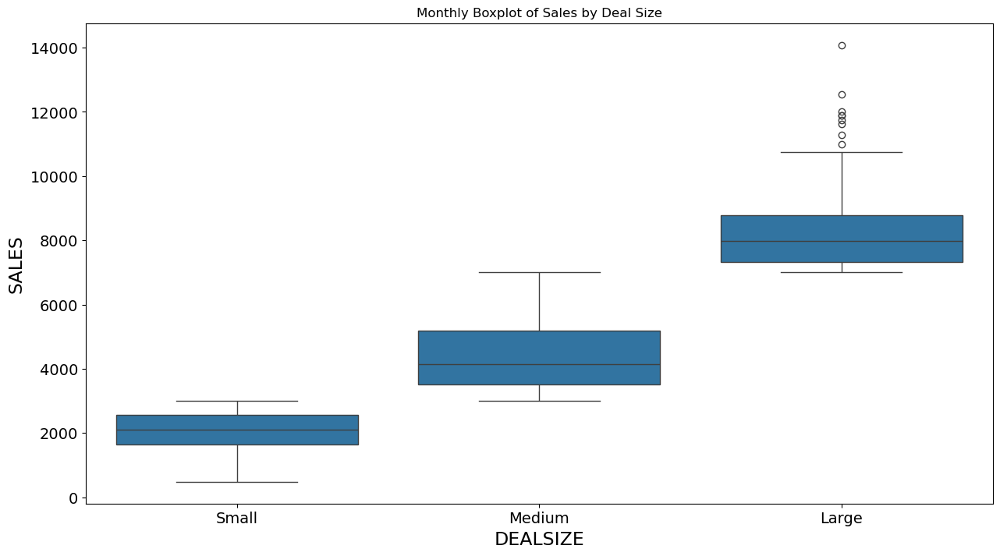

In [243]:
#boxplot of the monthly sales
sns.boxplot(x = sales_data.DEALSIZE,y = sales_data['SALES'])
plt.title("Monthly Boxplot of Sales by Deal Size")
plt.grid(False);

#### Observations

- We can see that the higher the percentage discount, the higher the sales
- SALES by COUNTRY: The sales by country show significant variation. Some countries have a higher median sales value, which could indicate a stronger market or a preference for more expensive products. This information can be vital for tailoring marketing strategies to different regions.
- SALES over time (ORDERDATE): The time series plot of sales indicates that there is a trend and possibly some seasonality in the sales data. There are peaks and troughs that may correspond to specific times of the year, such as holidays or sales seasons, which could be leveraged for promotional activities.
- SALES vs QUANTITYORDERED: There is a positive relationship between the quantity ordered and sales, which is expected since more items would generally lead to higher sales. However, the relationship doesn't appear to be strictly linear, suggesting that factors like discounts or bulk pricing may be in play.
- SALES vs PRICEEACH: There is a cluster of points at the lower end, indicating that many transactions happen with lower-priced items. However, the spread increases with price, indicating variability in sales amounts for higher-priced items.
- SALES by PRODUCTLINE: Different product lines show different sales distributions. Some product lines have a wider range of sales values, indicating that they may have more variability in the number of items sold or in their prices. This could suggest that certain product lines have more premium options or bulk sales.
- SALES by DEALSIZE: As expected, 'Small' deals have lower sales values, 'Medium' deals have higher sales values, and 'Large' deals have the highest sales values. This categorization seems to reflect the sales value well.



/var/folders/nc/l228b13146bf52hql4t835lc0000gn/T/ipykernel_131/790778238.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sb.heatmap(sales_data.corr(), cmap="YlGnBu", annot=True)


<Axes: >

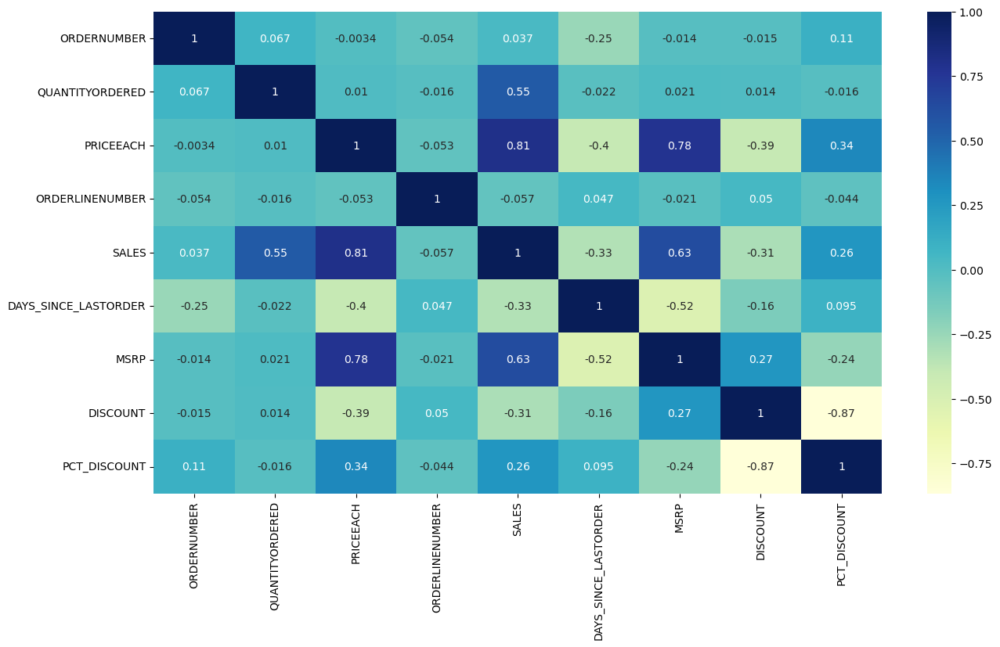

In [106]:
import seaborn as sb 
sb.heatmap(sales_data.corr(), cmap="YlGnBu", annot=True)

In [94]:
sales_data.head()

,ORDERNUMBER,QUANTITYORDERED,PRICEEACH,ORDERLINENUMBER,SALES,ORDERDATE,DAYS_SINCE_LASTORDER,STATUS,PRODUCTLINE,MSRP,...,CUSTOMERNAME,PHONE,ADDRESSLINE1,CITY,POSTALCODE,COUNTRY,CONTACTLASTNAME,CONTACTFIRSTNAME,DEALSIZE,DISCOUNT
0,10107,30,95.70,2,2871.00,2018-02-24,828,Shipped,Motorcycles,95,...,Land of Toys Inc.,2125557818,897 Long Airport Avenue,NYC,10022,USA,Yu,Kwai,Small,-0.70
1,10121,34,81.35,5,2765.90,2018-05-07,757,Shipped,Motorcycles,95,...,Reims Collectables,26.47.1555,59 rue de l'Abbaye,Reims,51100,France,Henriot,Paul,Small,13.65
2,10134,41,94.74,2,3884.34,2018-07-01,703,Shipped,Motorcycles,95,...,Lyon Souveniers,+33 1 46 62 7555,27 rue du Colonel Pierre Avia,Paris,75508,France,Da Cunha,Daniel,Medium,0.26
3,10145,45,83.26,6,3746.70,2018-08-25,649,Shipped,Motorcycles,95,...,Toys4GrownUps.com,6265557265,78934 Hillside Dr.,Pasadena,90003,USA,Young,Julie,Medium,11.74
4,10168,36,96.66,1,3479.76,2018-10-28,586,Shipped,Motorcycles,95,...,Technics Stores Inc.,6505556809,9408 Furth Circle,Burlingame,94217,USA,Hirano,Juri,Medium,-1.66


In [119]:
sales_data.groupby(sales_data.PRODUCTLINE)["PCT_DISCOUNT"].mean()

PRODUCTLINE
Classic Cars       -0.006383
Motorcycles         0.058874
Planes              0.034053
Ships               0.040943
Trains              0.176615
Trucks and Buses    0.040251
Vintage Cars        0.092112
Name: PCT_DISCOUNT, dtype: float64

In [ ]:
plt.scatter( sales_data.PCT_DISCOUNT,sales_data.SALES)

### Sales over Time

In [254]:
##create the days and months and the date columns to grow 
sales_data["MONTH_NAME"] = sales_data.ORDERDATE.dt.month_name()
sales_data["MONTH_NUM"] = sales_data.ORDERDATE.dt.month
sales_data["YEAR"] = sales_data.ORDERDATE.dt.year
sales_data["WEEK"] = sales_data.ORDERDATE.dt.week
sales_data["QUARTER"] = sales_data.ORDERDATE.dt.quarter

/var/folders/nc/l228b13146bf52hql4t835lc0000gn/T/ipykernel_27461/1195380053.py:5: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  sales_data["WEEK"] = sales_data.ORDERDATE.dt.week


In [ ]:
### we group the sales data by orderdate to get the daily sales 
sales_by_period = sales_data.groupby("ORDERDATE")["SALES"].sum().reset_index()
sales_by_period.head()

#set index of sales by period table to 
sales_by_period.set_index(keys='ORDERDATE',inplace=True)

In [531]:
sales_by_period.head()

,SALES
ORDERDATE,
2018-01-06,12133.25
2018-01-09,11432.34
2018-01-10,6864.05
2018-01-29,54702.00
2018-01-31,44621.96


In [537]:
sales_by_period.reset_index().groupby("ORDERDATE", as_index = False)["SALES"].sum()

,ORDERDATE,SALES
0,2018-01-06,12133.25
1,2018-01-09,11432.34
2,2018-01-10,6864.05
3,2018-01-29,54702.00
4,2018-01-31,44621.96
...,...,...
241,2020-05-13,31821.90
242,2020-05-17,59475.10
243,2020-05-29,51233.18
244,2020-05-30,14578.75


In [570]:
#show the performance across the years for the sparklingwine sales
# for the yearly trend we

alt.Chart(sales_by_period.resample('Q').sum().reset_index()).mark_line(point={
                                    "filled": False,
                                    "fill": "white"
                                    },
                                     strokeWidth=3).encode(
    x='quarter(ORDERDATE)', 
    y='SALES',
    column=alt.Column('year(ORDERDATE)',
     header=alt.Header(orient='top',
                                        #labelPadding=360,
                                        #labelAngle=-45,
                                        #labelOrient='bottom',
                                        #labelAlign='right',
                                        titleFontSize=20,  
                                        labelFontSize=20)),
    tooltip=['ORDERDATE', 'SALES']).properties(
    title="Sales: Quarterly Subseries plot"
    ).configure_header(
    titleColor='black',
    titleFontSize=17,
    labelColor='blue',
    labelFontSize=17
).properties(
   
    height=500
).configure_axis(
    labelFontSize=17,
    titleFontSize=17
).configure_title(fontSize= 17)

alt.Chart(...)

In [571]:
####gLooking at the monthly sales############
#####Group by the year ########
alt.Chart(sales_data.groupby("MONTH_NAME")["SALES"].sum().reset_index()).mark_line(point={
                                    "filled": False,
                                    "fill": "white"
                                    },
                                     strokeWidth=3).encode(
    x=alt.X('MONTH_NAME', sort = ["January","February", "March", "April","May","June","July","August","September","October","Novemebr","December"]), 
    y='SALES',
   
    tooltip=['MONTH_NAME', 'SALES']).properties(
    title="Sales: Monthly Subseries plot").configure_header(
    titleColor='black',
    titleFontSize=14,
    labelColor='blue',
    labelFontSize=14
).properties(
    width='container',
    height=500
).configure_axis(
    labelFontSize=17,
    titleFontSize=17
).configure_title(fontSize= 17)

alt.Chart(...)

In [323]:

####group by week and plot the graph 
alt.Chart(sales_data.groupby("WEEK")["SALES"].sum().reset_index()).mark_line(point={
                                    "filled": False,
                                    "fill": "white"
                                    },
                                     strokeWidth=3).encode(
    x='WEEK', 
    y='SALES',
    
    tooltip=['WEEK', 'SALES']).properties(
    title="Sales: Weekly Subseries plot").configure_header(
    titleColor='black',
    titleFontSize=14,
    labelColor='blue',
    labelFontSize=14
).properties(
    width='container',
    height=500
).configure_axis(
    labelFontSize=15,
    titleFontSize=15
).configure_title(fontSize= 17)




alt.Chart(...)

In [326]:
sales_data.head()

,ORDERNUMBER,QUANTITYORDERED,PRICEEACH,ORDERLINENUMBER,SALES,ORDERDATE,DAYS_SINCE_LASTORDER,STATUS,PRODUCTLINE,MSRP,...,DEALSIZE,MONTH,MONTH_NUM,YEAR,WEEK,QUARTER,DISCOUNT,PCT_DISCOUNT,Discount,MONTH_NAME
0,10107,30,95.70,2,2871.00,2018-02-24,828,Shipped,Motorcycles,95,...,Small,February,2,2018,8,1,-0.70,0.007368,Discuont,February
1,10121,34,81.35,5,2765.90,2018-05-07,757,Shipped,Motorcycles,95,...,Small,May,5,2018,19,2,13.65,-0.143684,Over MSRP,May
2,10134,41,94.74,2,3884.34,2018-07-01,703,Shipped,Motorcycles,95,...,Medium,July,7,2018,26,3,0.26,-0.002737,Over MSRP,July
3,10145,45,83.26,6,3746.70,2018-08-25,649,Shipped,Motorcycles,95,...,Medium,August,8,2018,34,3,11.74,-0.123579,Over MSRP,August
4,10168,36,96.66,1,3479.76,2018-10-28,586,Shipped,Motorcycles,95,...,Medium,October,10,2018,43,4,-1.66,0.017474,Discuont,October


In [ ]:
sales_data.groupby("MONTH_NAME")["SALES"].sum().reset_index()).mark_line(point={
                                    "filled": False,
                                    "fill": "white"
                                    },
                                     strokeWidth=3).encode(
    x=alt.X('MONTH_NAME', sort = ["January","February", "March", "April","May","June","July","August","September","October","Novemebr","December"]), 
    

In [568]:
##showing the stream chart of the sales 
source = sales_data.groupby(["ORDERDATE","PRODUCTLINE"], as_index = False).agg(
        total_sales = ("SALES","sum"),
        total_orders = ("ORDERNUMBER", "nunique")
)


alt.Chart(source).mark_area().encode(
    alt.X('month(ORDERDATE):T').axis(format='%m', domain=False, tickSize=0),
    alt.Y('sum(total_sales):Q').stack('center').axis(None),
    alt.Color('PRODUCTLINE:N').scale(scheme='category20b')
).properties(
    width='container',
    height=500
).configure_axis(
    labelFontSize=15,
    titleFontSize=15
).configure_title(fontSize= 17)


alt.Chart(...)

In [343]:
sales_data

,ORDERNUMBER,QUANTITYORDERED,PRICEEACH,ORDERLINENUMBER,SALES,ORDERDATE,DAYS_SINCE_LASTORDER,STATUS,PRODUCTLINE,MSRP,...,DEALSIZE,MONTH,MONTH_NUM,YEAR,WEEK,QUARTER,DISCOUNT,PCT_DISCOUNT,Discount,MONTH_NAME
0,10107,30,95.70,2,2871.00,2018-02-24,828,Shipped,Motorcycles,95,...,Small,February,2,2018,8,1,-0.70,0.007368,Discuont,February
1,10121,34,81.35,5,2765.90,2018-05-07,757,Shipped,Motorcycles,95,...,Small,May,5,2018,19,2,13.65,-0.143684,Over MSRP,May
2,10134,41,94.74,2,3884.34,2018-07-01,703,Shipped,Motorcycles,95,...,Medium,July,7,2018,26,3,0.26,-0.002737,Over MSRP,July
3,10145,45,83.26,6,3746.70,2018-08-25,649,Shipped,Motorcycles,95,...,Medium,August,8,2018,34,3,11.74,-0.123579,Over MSRP,August
4,10168,36,96.66,1,3479.76,2018-10-28,586,Shipped,Motorcycles,95,...,Medium,October,10,2018,43,4,-1.66,0.017474,Discuont,October
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2742,10350,20,112.22,15,2244.40,2019-12-02,2924,Shipped,Ships,54,...,Small,December,12,2019,49,4,-58.22,1.078148,Discuont,December
2743,10373,29,137.19,1,3978.51,2020-01-31,2865,Shipped,Ships,54,...,Medium,January,1,2020,5,1,-83.19,1.540556,Discuont,January
2744,10386,43,125.99,4,5417.57,2020-03-01,2836,Resolved,Ships,54,...,Medium,March,3,2020,9,1,-71.99,1.333148,Discuont,March
2745,10397,34,62.24,1,2116.16,2020-03-28,2810,Shipped,Ships,54,...,Small,March,3,2020,13,1,-8.24,0.152593,Discuont,March


In [346]:
sales_data_total_in = sales_data.groupby(["COUNTRY","PRODUCTLINE"], as_index=False).agg(
    total_sales = ("SALES","sum")
)

In [347]:
sales_data_total_in.head()

,COUNTRY,PRODUCTLINE,total_sales
0,Australia,Classic Cars,193085.54
1,Australia,Motorcycles,89968.76
2,Australia,Planes,74853.87
3,Australia,Ships,4159.76
4,Australia,Trains,1681.35


In [381]:
countries_to_analyse

['USA',
 'Spain',
 'France',
 'Australia',
 'UK',
 'Italy',
 'Finland',
 'Norway',
 'Singapore']

In [521]:
#####showing the distribution of the prodcutlines in the different countries
#source = sales_data_total_in[sales_data_total_in["COUNTRY"].isin(countries_to_analyse)]
source = sales_data_total_in


alt.Chart(source).mark_bar().encode(
            alt.X("PRODUCTLINE:N",axis=alt.Axis(title="")).sort('-y'),
            y=alt.Y('total_sales'),
            color=alt.Color('PRODUCTLINE:N',legend=alt.Legend(orient="top")),
                facet=alt.Facet('COUNTRY:N',
                    sort={
                        'field': 'total_sales',
                        'op': 'sum',
                        'order': 'descending'
                    },
                    columns=5
                )
            
            
        )
        
        
       

alt.Chart(...)

### Observations

- 2019 was the highest trending year in terms of sales 
- We can see that sales slowly trend up duriing each quarter from quarter on to quarter three with a massive spike in quarter 4 for sales with quarter four contributing the most to yearly sales by far
- The monthly sales show two overall peaks in the 5th month and the 11th month showing two periods of increased demand. The first peak is driven by the high quarter 3 sales performance in 2019 
- We can see that most of our sales happen in the month of November and as such we need to run promotions and set dicounts in line with this
- The weekly plot also shows a high peak in the latter parts of the year (fourth quarter) which coi-incides with all our other graphs and analysis showing increased demand in the last quarter
- This shows the seasonal nature of our products and might speak to how our products are luxury products and as such marketing efforts should be tailored to fall in line with periods of demand
- We can see that the sales behave the same way across the different products over time as shown by the stream graph


### How effective is our dicounting cycle or pricing Strategy

In [ ]:
##adding discount amount to see how the discount affects the sales 
#the discount is the difference between the manufatured recommended price and the price we sell them at ( I call it discount)

sales_data['DISCOUNT'] = sales_data["MSRP"] - sales_data['PRICEEACH'] 
sales_data['PCT_DISCOUNT'] = sales_data[['MSRP','PRICEEACH']].pct_change(axis = 1)["PRICEEACH"]


In [188]:
####getting the average range of the discounts to see the effect of discounts on the sales
discount_data_frame = sales_data.merge(sales_data.groupby("ORDERDATE", as_index = False).agg(
                            MIN_DISCOUNT = ("PCT_DISCOUNT", 'min'),
                            MAX_DISCOUNT = ("PCT_DISCOUNT", 'max'),
                            MIN_PRICEEACH = ("PRICEEACH", 'min'),
                            MAX_PRICEEACH = ("PRICEEACH", 'max'),


), how = "left"
)

In [139]:
source = discount_data_frame.groupby("MONTH_NUM", as_index=False).agg(
                                         PCT_DISCNT= ("PCT_DISCOUNT", 'median'),
                                         SALES= ("SALES", 'sum'),
                                          MIN_DISCOUNT = ("MIN_DISCOUNT", 'mean'),
                                         MAX_DISCOUNT = ("MAX_DISCOUNT", 'mean')
    
                                )


base = alt.Chart(source).encode(
    alt.X('MONTH_NUM', axis=alt.Axis(title=None))
).properties(
    width='container',
    height=500
)

area = base.mark_area(opacity=0.3, color='#57A44C').encode(
    alt.Y('MIN_DISCOUNT',
          axis=alt.Axis(title='Percentage Discount', titleColor='#57A44C')),
    alt.Y2('MAX_DISCOUNT')
)

#line = base.mark_line(stroke='#57A44C', interpolate='monotone').encode(
#    alt.Y('PCT_DISCNT',
 #         axis=alt.Axis(title='Percentage Discount', titleColor='#57A44C'))
#)


line = base.mark_line(stroke='#5276A7', interpolate='monotone').encode(
    alt.Y('SALES',
          axis=alt.Axis(title='SALES', titleColor='#5276A7'))
)


lines = base.mark_line(stroke='#5276A7', interpolate='monotone').encode(
    alt.Y('PCT_DISCNT')
)


alt.layer(area, line).resolve_scale(
    y = 'independent'
)

alt.LayerChart(...)

In [ ]:
### seeing the effect of disocunts on the price so we can color by that 
conditions = [
        (sales_data["PCT_DISCOUNT"] > 0 ),
        (sales_data["PCT_DISCOUNT"] == 0 ),
        (sales_data["PCT_DISCOUNT"] < 0 )
]

choices = ["Discuont", "MSRP", "Over MSRP"]
sales_data["Discount"] = np.select(conditions, choices, default = 0)

In [312]:
#sns.boxplot(x = sales_data.PRODUCTLINE,y = sales_data.SALES, hue = sales_data.Discount)
source = sales_data

alt.Chart(source).mark_boxplot().encode(
    x=alt.X("Discount:N", title=None, axis=alt.Axis(labels=False, ticks=False), scale=alt.Scale(padding=2)),
    y=alt.Y("SALES:Q").scale(zero=False),
    color=alt.Color("Discount:N",legend = alt.Legend(labelFontSize = 15, titleFontSize=15)),
    column=alt.Column('PRODUCTLINE:N',
                     header=alt.Header(orient='bottom',
                                        #labelPadding=360,
                                        labelAngle=-45,
                                        labelOrient='bottom',
                                        labelAlign='right',
                                        titleFontSize=20,  
                                        labelFontSize=17)
                                        ),
    
    
    #alt.Color("Discount:N").legend(None),
).configure_facet(
    spacing=0
).configure_view(
    stroke=None
).properties(
    width= 115,
    height=500
).configure_axis(
    labelFontSize=17,
    titleFontSize=17
).configure_title(fontSize= 17)

alt.Chart(...)

### Observations
- We can see that we generally run high discounts during the first quarter and the last quarter with higher than average sales preceeding the first quarter discounts 
- It seems that the discounts in the 4th quarter track perfectly with the demand during the period and this lines up with increased demnad
- We can see from the boxplot that the discounts generally drive more sales for each product category so we are better off selling our product below the manufacturer recommended price where we can 

### Sales by different periods per group


In [144]:
sales_data["MONTH"] = sales_data.ORDERDATE.dt.month_name()
sales_data["MONTH_NUM"] = sales_data.ORDERDATE.dt.month
sales_data["YEAR"] = sales_data.ORDERDATE.dt.year
sales_data["WEEK"] = sales_data.ORDERDATE.dt.week
sales_data["QUARTER"] = sales_data.ORDERDATE.dt.quarter

/var/folders/nc/l228b13146bf52hql4t835lc0000gn/T/ipykernel_131/1617235841.py:4: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  sales_data["WEEK"] = sales_data.ORDERDATE.dt.week


In [146]:
sales_data.head(4)

,ORDERNUMBER,QUANTITYORDERED,PRICEEACH,ORDERLINENUMBER,SALES,ORDERDATE,DAYS_SINCE_LASTORDER,STATUS,PRODUCTLINE,MSRP,...,CONTACTLASTNAME,CONTACTFIRSTNAME,DEALSIZE,DISCOUNT,PCT_DISCOUNT,MONTH,YEAR,WEEK,MONTH_NUM,QUARTER
0,10107,30,95.70,2,2871.00,2018-02-24,828,Shipped,Motorcycles,95,...,Yu,Kwai,Small,-0.70,0.007368,February,2018,8,2,1
1,10121,34,81.35,5,2765.90,2018-05-07,757,Shipped,Motorcycles,95,...,Henriot,Paul,Small,13.65,-0.143684,May,2018,19,5,2
2,10134,41,94.74,2,3884.34,2018-07-01,703,Shipped,Motorcycles,95,...,Da Cunha,Daniel,Medium,0.26,-0.002737,July,2018,26,7,3
3,10145,45,83.26,6,3746.70,2018-08-25,649,Shipped,Motorcycles,95,...,Young,Julie,Medium,11.74,-0.123579,August,2018,34,8,3


/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


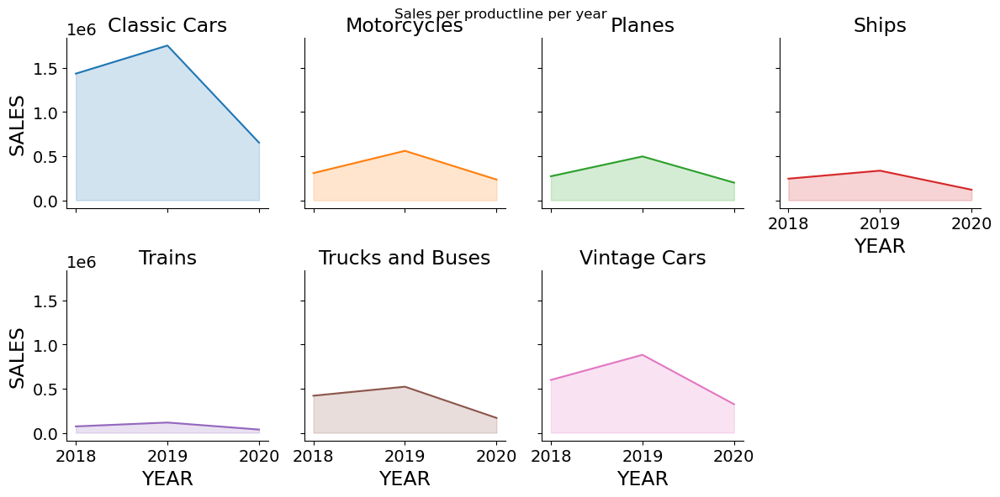

In [246]:


# Create a grid : initialize it
g = sns.FacetGrid(sales_data.groupby(["YEAR","PRODUCTLINE"])["SALES"].sum().reset_index(), col='PRODUCTLINE', hue='PRODUCTLINE', col_wrap=4, )

# Add the line over the area with the plot function
g = g.map(plt.plot, 'YEAR', 'SALES')
 
# Fill the area with fill_between
g = g.map(plt.fill_between, 'YEAR', 'SALES', alpha=0.2).set_titles("{col_name} country")

# Control the title of each facet
g = g.set_titles("{col_name}")
 
# Add a title for the whole plot
plt.subplots_adjust(top=0.92)
g = g.fig.suptitle('Sales per productline per year')

# Show the graph
plt.show()

/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


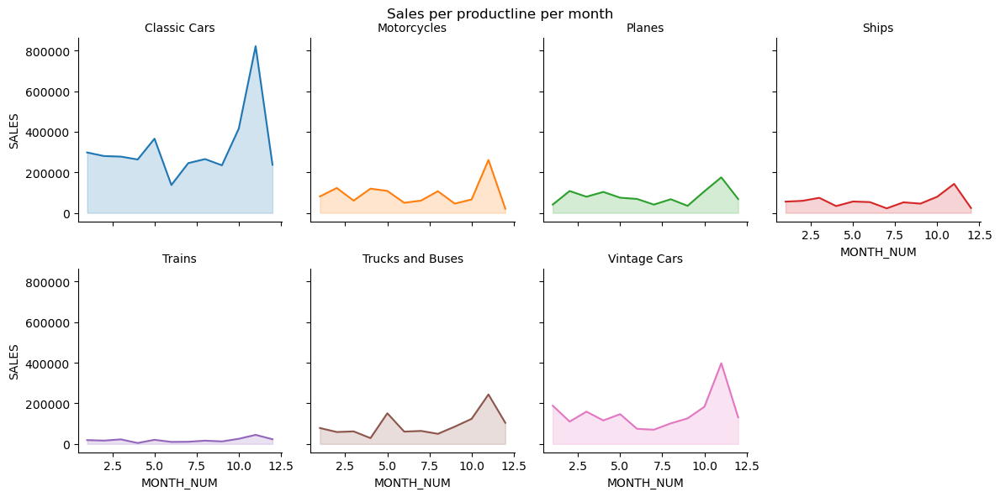

In [47]:
# Create a grid : initialize it
g = sns.FacetGrid(sales_data.groupby(["MONTH_NUM","PRODUCTLINE"])["SALES"].sum().reset_index(), col='PRODUCTLINE', hue='PRODUCTLINE', col_wrap=4, )

# Add the line over the area with the plot function
g = g.map(plt.plot, 'MONTH_NUM', 'SALES')
 
# Fill the area with fill_between
g = g.map(plt.fill_between, 'MONTH_NUM', 'SALES', alpha=0.2).set_titles("{col_name} country")
 
# Control the title of each facet
g = g.set_titles("{col_name}")
 
# Add a title for the whole plot
plt.subplots_adjust(top=0.92)
g = g.fig.suptitle('Sales per productline per month')

# Show the graph
plt.show()

### Observation 
- We can see that the moonthly trend for the different products follows a similar pattern

/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


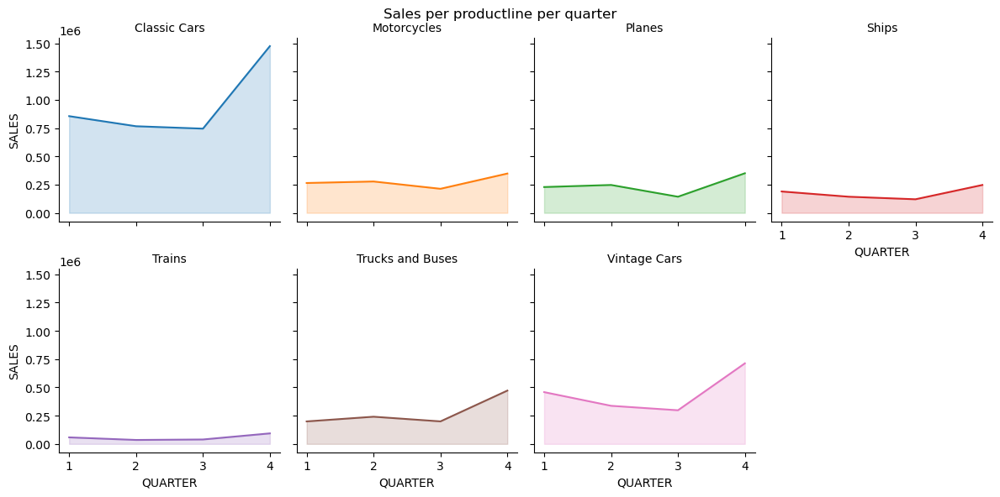

In [233]:
# Create a grid : initialize it
g = sns.FacetGrid(sales_data.groupby(["QUARTER","PRODUCTLINE"])["SALES"].sum().reset_index(), col='PRODUCTLINE', hue='PRODUCTLINE', col_wrap=4, )

# Add the line over the area with the plot function
g = g.map(plt.plot, 'QUARTER', 'SALES')
 
# Fill the area with fill_between
g = g.map(plt.fill_between, 'QUARTER', 'SALES', alpha=0.2).set_titles("{col_name} country")
 
# Control the title of each facet
g = g.set_titles("{col_name}", fontdict={'size': 17})

# Add a title for the whole plot
plt.subplots_adjust(top=0.92)
g = g.fig.suptitle('Sales per productline per quarter')

# Show the graph
plt.show()

### Observation 

- We can see that the quarterly trend is the same across the different quarter

/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


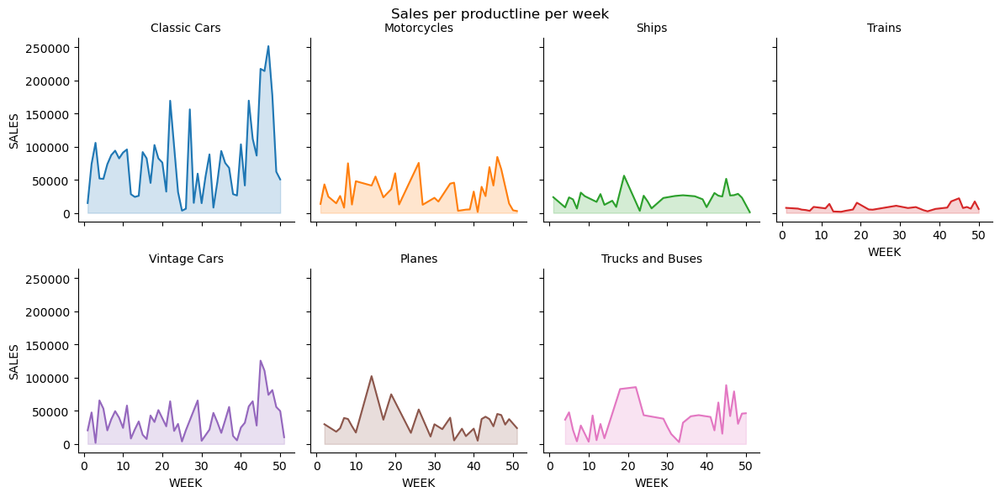

In [49]:
# Create a grid : initialize it
g = sns.FacetGrid(sales_data.groupby(["WEEK","PRODUCTLINE"])["SALES"].sum().reset_index(), col='PRODUCTLINE', hue='PRODUCTLINE', col_wrap=4, )

# Add the line over the area with the plot function
g = g.map(plt.plot, 'WEEK', 'SALES')
 
# Fill the area with fill_between
g = g.map(plt.fill_between, 'WEEK', 'SALES', alpha=0.2).set_titles("{col_name} country")
 
# Control the title of each facet
g = g.set_titles("{col_name}")
 
# Add a title for the whole plot
plt.subplots_adjust(top=0.92)
g = g.fig.suptitle('Sales per productline per week')

# Show the graph
plt.show()

#### Observations

- The trend of the products by year, quarter and month generally follow the same pattern and are similar
- The weekly trends are slightly different but all show a peak in the week 40 to 50 which is towards the end of the year and coincides with the peak in sales in November 
- The sales geneally maintain the same level across quarters seeing a peak in the fourth quarter for most of the products so the company might want to set more discounts during this period as it aligns with peak demand probably due to products being bought as presents or due to higher income due to bonus seasson
- 2019 was the highest performing period but the data for 2020 does not cover all the months so a full analysis on the yearly trend cannot be implemented or ran

#### Sales by Country 

/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


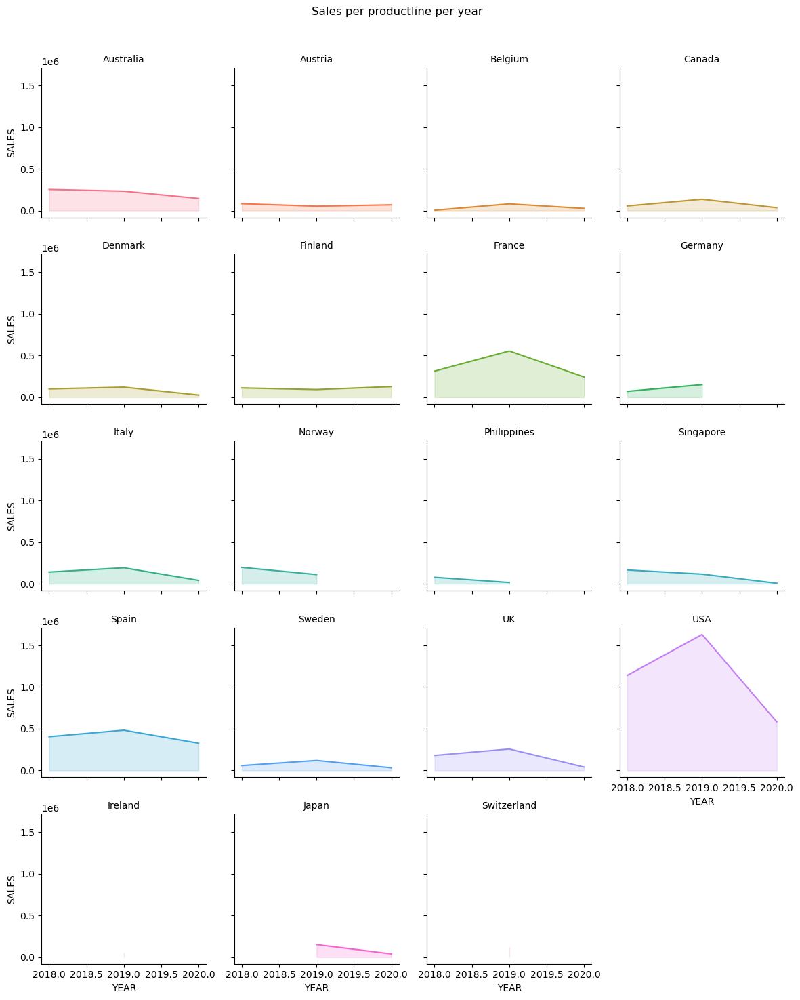

In [78]:
# Create a grid : initialize it
g = sns.FacetGrid(sales_data.groupby(["YEAR","COUNTRY"])["SALES"].sum().reset_index(), col='COUNTRY', hue='COUNTRY', col_wrap=4, )

# Add the line over the area with the plot function
g = g.map(plt.plot, 'YEAR', 'SALES')
 
# Fill the area with fill_between
g = g.map(plt.fill_between, 'YEAR', 'SALES', alpha=0.2).set_titles("{col_name} country")

# Control the title of each facet
g = g.set_titles("{col_name}")
 
# Add a title for the whole plot
plt.subplots_adjust(top=0.92)
g = g.fig.suptitle('Sales per productline per year')

# Show the graph
plt.show()

### Observation 

- You can see that some of the countries do not order throughout the year
- In general the yearly trend is the same for countries that do order throughout the year

/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


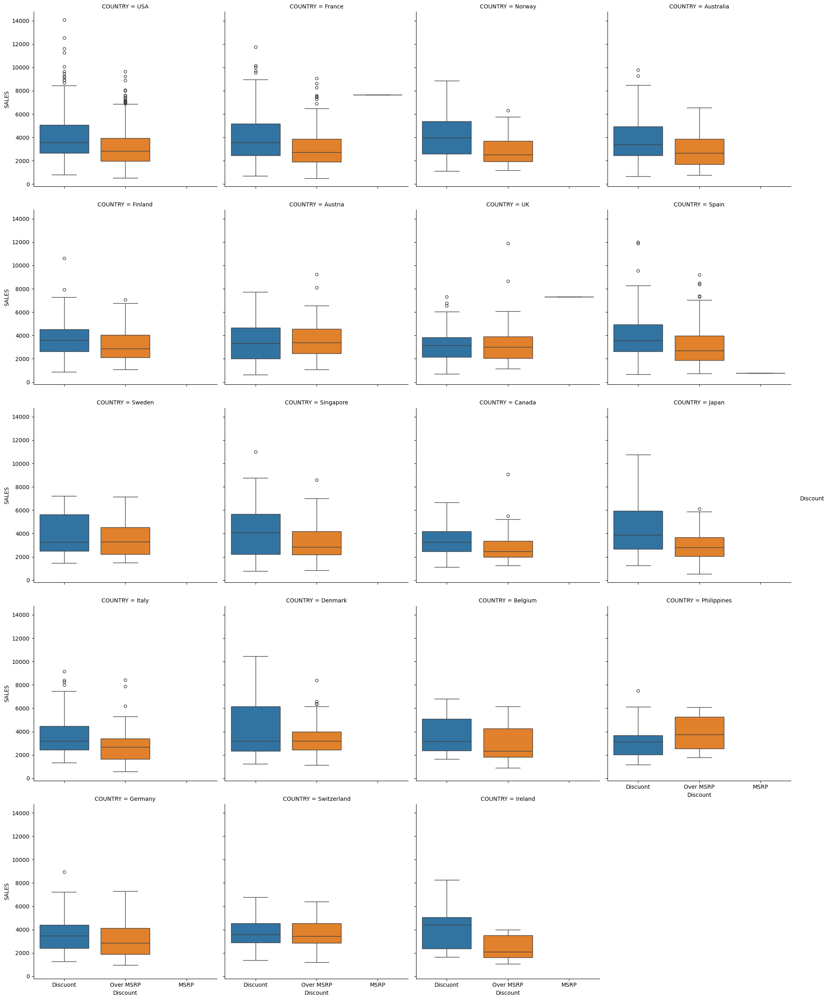

In [181]:
sns.catplot(
    data=sales_data, x='Discount', y='SALES',
    col='COUNTRY', kind='box', col_wrap=4, hue = 'Discount'
)

### Observations
- We can see that there are countries in the data that do not order during the whole year
- The Unites States is the country with the most orders but each country seems to follow a similar pattern in terms of orders
- We can see that in most countries 

### Effect of discounts

/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


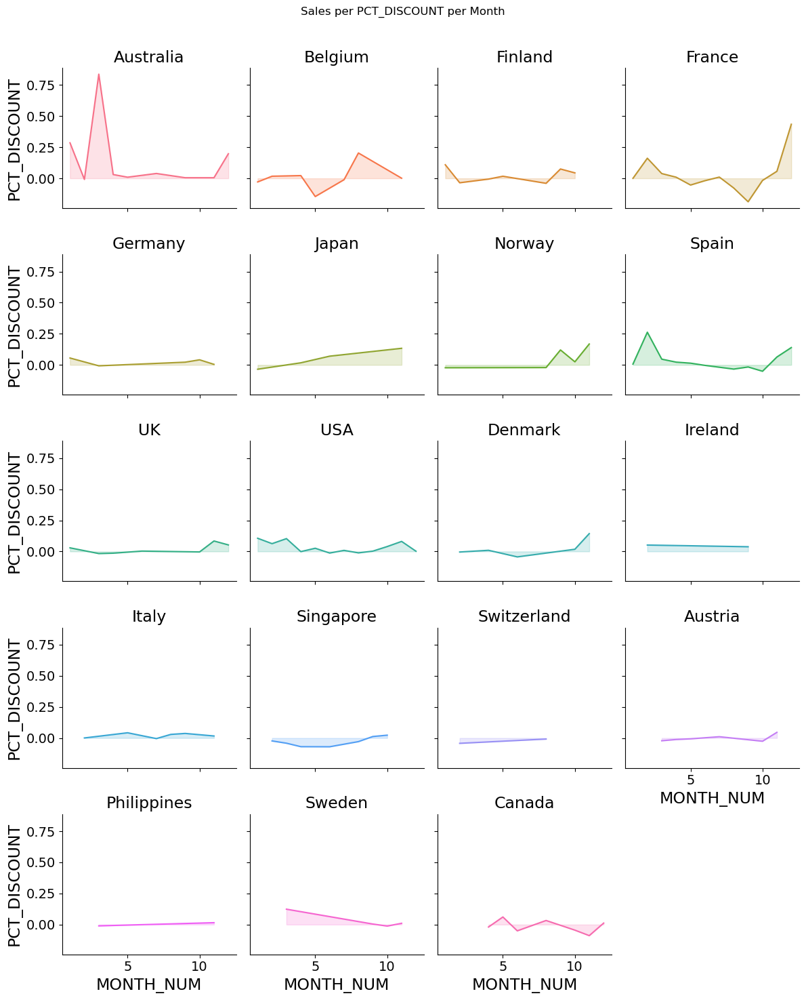

In [549]:
# Create a grid : initialize it
g = sns.FacetGrid(sales_data.groupby(["MONTH_NUM","COUNTRY"])["PCT_DISCOUNT"].mean().reset_index(), col='COUNTRY', hue='COUNTRY', col_wrap=4, )

# Add the line over the area with the plot function
g = g.map(plt.plot, 'MONTH_NUM', 'PCT_DISCOUNT')
 
# Fill the area with fill_between
g = g.map(plt.fill_between, 'MONTH_NUM', 'PCT_DISCOUNT', alpha=0.2).set_titles("{col_name} country")

# Control the title of each facet
g = g.set_titles("{col_name}")
 
# Add a title for the whole plot
plt.subplots_adjust(top=0.92)
g = g.fig.suptitle('Sales per PCT_DISCOUNT per Month')

# Show the graph
plt.show()

/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/georgemamvura/anaconda3/envs/timeseries_great_learning/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


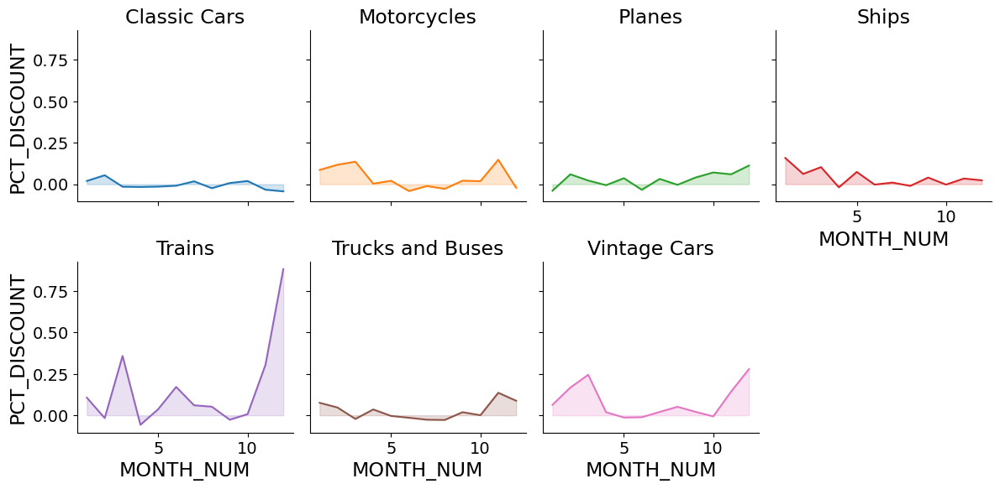

In [567]:
# Create a grid : initialize it
g = sns.FacetGrid(sales_data.groupby(["MONTH_NUM","PRODUCTLINE"])["PCT_DISCOUNT"].mean().reset_index(), col='PRODUCTLINE', hue='PRODUCTLINE', col_wrap=4, )

# Add the line over the area with the plot function
g = g.map(plt.plot, 'MONTH_NUM', 'PCT_DISCOUNT')
 
# Fill the area with fill_between
g = g.map(plt.fill_between, 'MONTH_NUM', 'PCT_DISCOUNT', alpha=0.2).set_titles("{col_name} country")

# Control the title of each facet
g = g.set_titles("{col_name}")
 
# Add a title for the whole plot
plt.subplots_adjust(top=0.92)
#g = g.fig.suptitle('Sales per PCT_DISCOUNT per Productline')

# Show the graph
plt.show()

### Observation 

- All other products except Classic cars have an average percentage discount that is greater than zero during the end of the year. We can potentially set up a promotion selling discounted cars at slightly lower prices to boost sales as we have shown that 


## RFM Analysis

In [572]:
import os 


###set file name to the current working directory where the full code notebook is so we can open the file 
file_name = f"""{os.getcwd()}/RFM_ANALYSIS.csv"""


## read the data 
data_rfm = pd.read_csv(file_name)


In [603]:
data_rfm.groupby(["Monetary","Frequency","Recency"], as_index= False).agg(
            num_customers = ("CUSTOMERNAME", "count")
)

,Monetary,Frequency,Recency,num_customers
0,H,H,H,11
1,H,H,L,1
2,H,H,M,3
3,H,M,H,1
4,H,M,L,1
5,H,M,M,5
6,L,H,L,1
7,L,L,L,5
8,L,L,M,10
9,L,M,H,1


In [618]:
source = data_rfm.groupby(["Frequency","Recency"], as_index= False).agg(
            num_customers = ("CUSTOMERNAME", "count")
)

In [682]:
data_rfm.head()

,CUSTOMERNAME,FREQUENCY [Binned],MONETARY [Binned],RECENCY [Binned],Monetary,Frequency,Recency
0,"AV Stores, Co.",Bin 2,Bin 3,Bin 2,H,M,M
1,Alpha Cognac,Bin 2,Bin 1,Bin 3,L,M,L
2,Amica Models & Co.,Bin 1,Bin 2,Bin 2,M,L,M
3,"Anna's Decorations, Ltd",Bin 3,Bin 3,Bin 1,H,H,H
4,Atelier graphique,Bin 2,Bin 1,Bin 2,L,M,M


In [685]:
###setting the categorical order of the data and the values
data_rfm["Monetary"] = data_rfm["Monetary"].astype(pd.api.types.CategoricalDtype(categories= ["H", "M", "L"]))
data_rfm["Frequency"] = data_rfm["Frequency"].astype(pd.api.types.CategoricalDtype(categories= ["H", "M", "L"]))
data_rfm["Recency"] = data_rfm["Recency"].astype(pd.api.types.CategoricalDtype(categories= ["H", "M", "L"]))

In [ ]:
heatmap_table = pd.pivot_table(
        data_rfm,
        values = ["CUSTOMERNAME"],
        index = ["Monetary", "Frequency"],
        columns = ["Recency"], aggfunc= [round(len)],
        margins=False

).fillna('')

In [703]:
heatmap_table = pd.pivot_table(
        data_rfm,
        values = ["CUSTOMERNAME"],
        index = ["Recency", "Frequency"],
        columns = ["Monetary"], aggfunc= lambda x: int(len(x)),
        margins=False

).fillna('')

In [704]:
heatmap_table.head()

CUSTOMERNAME            
Monetary                     H     M     L
Recency Frequency                         
H       H                 11.0   1.0      
        M                  1.0   9.0   1.0
M       H                  3.0   3.0      
        M                  5.0  11.0   1.0
        L                       11.0  10.0

In [705]:
##apply coloring to the table such that the colors are as follows: green for High monetary value, Yellow for Medium monetary value and red for low
heatmap_table.style.apply(
    lambda ser: ['background: green' if ser.name[0] == 'H' else 
                 'background: yellow' if ser.name[0] == 'M' else 
                 'background: red' if ser.name[0] == 'L' else '' 
                 for _ in ser],
    axis=1)

In [706]:
heatmap_table.to_csv("rfm_analsis_table.csv")

In [707]:
data_rfm.head()

,CUSTOMERNAME,FREQUENCY [Binned],MONETARY [Binned],RECENCY [Binned],Monetary,Frequency,Recency
0,"AV Stores, Co.",Bin 2,Bin 3,Bin 2,H,M,M
1,Alpha Cognac,Bin 2,Bin 1,Bin 3,L,M,L
2,Amica Models & Co.,Bin 1,Bin 2,Bin 2,M,L,M
3,"Anna's Decorations, Ltd",Bin 3,Bin 3,Bin 1,H,H,H
4,Atelier graphique,Bin 2,Bin 1,Bin 2,L,M,M


In [709]:
#create the data_table to group the different customers and set them in a group 

data_rfm["RFM"] = data_rfm["Recency"].astype(str) + data_rfm["Frequency"].astype(str) + data_rfm["Monetary"].astype(str)

In [710]:
data_rfm.head()

,CUSTOMERNAME,FREQUENCY [Binned],MONETARY [Binned],RECENCY [Binned],Monetary,Frequency,Recency,RFM
0,"AV Stores, Co.",Bin 2,Bin 3,Bin 2,H,M,M,MMH
1,Alpha Cognac,Bin 2,Bin 1,Bin 3,L,M,L,LML
2,Amica Models & Co.,Bin 1,Bin 2,Bin 2,M,L,M,MLM
3,"Anna's Decorations, Ltd",Bin 3,Bin 3,Bin 1,H,H,H,HHH
4,Atelier graphique,Bin 2,Bin 1,Bin 2,L,M,M,MML


In [736]:
segment =[""] * len(data_rfm["RFM"])

for i in range(0,len(data_rfm)):
    if data_rfm["RFM"][i] == "HHH":
        segment[i] = "High Value Customers"
    elif data_rfm["RFM"][i] in ["HHM", "HHL", "MHM", "MHL", "MMH","HML","HMM","MHH","HMH","MMM","MML"]:
        segment[i] = "Loyal Customers"
    elif data_rfm["RFM"][i] in ["LHH", "LHM", "LMM", "LMH", "LML","LHL"]:
        segment[i] = "At Risk"
    elif data_rfm["RFM"][i] in ["LLL", "LLM","LLM","MLM", "MLL"]:
        segment[i] = "Churned or Low Priority"

In [738]:
segment

['Loyal Customers',
 'At Risk',
 'Churned or Low Priority',
 'High Value Customers',
 'Loyal Customers',
 'At Risk',
 'High Value Customers',
 'Loyal Customers',
 'Churned or Low Priority',
 'Loyal Customers',
 'At Risk',
 'Loyal Customers',
 'Churned or Low Priority',
 'At Risk',
 'Churned or Low Priority',
 'Churned or Low Priority',
 'Churned or Low Priority',
 'Churned or Low Priority',
 'Churned or Low Priority',
 'Loyal Customers',
 'Churned or Low Priority',
 'Churned or Low Priority',
 'Loyal Customers',
 'Loyal Customers',
 'At Risk',
 'Churned or Low Priority',
 'Loyal Customers',
 'High Value Customers',
 'Churned or Low Priority',
 'Churned or Low Priority',
 'At Risk',
 'At Risk',
 'High Value Customers',
 'Loyal Customers',
 'Loyal Customers',
 'At Risk',
 'Loyal Customers',
 'Loyal Customers',
 'Churned or Low Priority',
 'Loyal Customers',
 'Churned or Low Priority',
 'Loyal Customers',
 'Loyal Customers',
 'High Value Customers',
 'High Value Customers',
 'Loyal Custom

In [739]:
##add the group into the dataframe
data_rfm["group"] = segment

In [741]:
data_rfm.groupby("group", as_index=False).count()

,group,CUSTOMERNAME,FREQUENCY [Binned],MONETARY [Binned],RECENCY [Binned],Monetary,Frequency,Recency,RFM
0,At Risk,15,15,15,15,15,15,15,15
1,Churned or Low Priority,28,28,28,28,28,28,28,28
2,High Value Customers,11,11,11,11,11,11,11,11
3,Loyal Customers,35,35,35,35,35,35,35,35


In [747]:
data_rfm.head()

,CUSTOMERNAME,FREQUENCY [Binned],MONETARY [Binned],RECENCY [Binned],Monetary,Frequency,Recency,RFM,group
0,"AV Stores, Co.",Bin 2,Bin 3,Bin 2,H,M,M,MMH,Loyal Customers
1,Alpha Cognac,Bin 2,Bin 1,Bin 3,L,M,L,LML,At Risk
2,Amica Models & Co.,Bin 1,Bin 2,Bin 2,M,L,M,MLM,Churned or Low Priority
3,"Anna's Decorations, Ltd",Bin 3,Bin 3,Bin 1,H,H,H,HHH,High Value Customers
4,Atelier graphique,Bin 2,Bin 1,Bin 2,L,M,M,MML,Loyal Customers


In [748]:
data_rfm.group.unique()

array(['Loyal Customers', 'At Risk', 'Churned or Low Priority',
       'High Value Customers'], dtype=object)

In [750]:
###filtering the different groups
data_rfm.filter(items=data_rfm.columns).query('group == "High Value Customers"')

,CUSTOMERNAME,FREQUENCY [Binned],MONETARY [Binned],RECENCY [Binned],Monetary,Frequency,Recency,RFM,group
3,"Anna's Decorations, Ltd",Bin 3,Bin 3,Bin 1,H,H,H,HHH,High Value Customers
6,"Australian Collectors, Co.",Bin 3,Bin 3,Bin 1,H,H,H,HHH,High Value Customers
27,Diecast Classics Inc.,Bin 3,Bin 3,Bin 1,H,H,H,HHH,High Value Customers
32,Euro Shopping Channel,Bin 3,Bin 3,Bin 1,H,H,H,HHH,High Value Customers
43,La Rochelle Gifts,Bin 3,Bin 3,Bin 1,H,H,H,HHH,High Value Customers
44,Land of Toys Inc.,Bin 3,Bin 3,Bin 1,H,H,H,HHH,High Value Customers
53,Mini Gifts Distributors Ltd.,Bin 3,Bin 3,Bin 1,H,H,H,HHH,High Value Customers
67,Salzburg Collectables,Bin 3,Bin 3,Bin 1,H,H,H,HHH,High Value Customers
72,Souveniers And Things Co.,Bin 3,Bin 3,Bin 1,H,H,H,HHH,High Value Customers
76,Technics Stores Inc.,Bin 3,Bin 3,Bin 1,H,H,H,HHH,High Value Customers


In [751]:
###filtering the different groups
data_rfm.filter(items=data_rfm.columns).query('group == "Loyal Customers"')

,CUSTOMERNAME,FREQUENCY [Binned],MONETARY [Binned],RECENCY [Binned],Monetary,Frequency,Recency,RFM,group
0,"AV Stores, Co.",Bin 2,Bin 3,Bin 2,H,M,M,MMH,Loyal Customers
4,Atelier graphique,Bin 2,Bin 1,Bin 2,L,M,M,MML,Loyal Customers
7,"Australian Gift Network, Co",Bin 2,Bin 1,Bin 1,L,M,H,HML,Loyal Customers
9,Auto Canal Petit,Bin 2,Bin 2,Bin 1,M,M,H,HMM,Loyal Customers
11,Baane Mini Imports,Bin 3,Bin 2,Bin 1,M,H,H,HHM,Loyal Customers
19,Classic Legends Inc.,Bin 2,Bin 2,Bin 2,M,M,M,MMM,Loyal Customers
22,Collectables For Less Inc.,Bin 2,Bin 2,Bin 1,M,M,H,HMM,Loyal Customers
23,"Corrida Auto Replicas, Ltd",Bin 2,Bin 3,Bin 2,H,M,M,MMH,Loyal Customers
26,Danish Wholesale Imports,Bin 3,Bin 3,Bin 2,H,H,M,MHH,Loyal Customers
33,FunGiftIdeas.com,Bin 2,Bin 2,Bin 1,M,M,H,HMM,Loyal Customers


In [752]:
###filtering the different groups
data_rfm.filter(items=data_rfm.columns).query('group == "At Risk"')

,CUSTOMERNAME,FREQUENCY [Binned],MONETARY [Binned],RECENCY [Binned],Monetary,Frequency,Recency,RFM,group
1,Alpha Cognac,Bin 2,Bin 1,Bin 3,L,M,L,LML,At Risk
5,"Australian Collectables, Ltd",Bin 2,Bin 1,Bin 3,L,M,L,LML,At Risk
10,Auto-Moto Classics Inc.,Bin 2,Bin 1,Bin 3,L,M,L,LML,At Risk
13,"Blauer See Auto, Co.",Bin 3,Bin 2,Bin 3,M,H,L,LHM,At Risk
24,Cruz & Sons Co.,Bin 2,Bin 2,Bin 3,M,M,L,LMM,At Risk
30,"Dragon Souveniers, Ltd.",Bin 3,Bin 3,Bin 3,H,H,L,LHH,At Risk
31,Enaco Distributors,Bin 2,Bin 2,Bin 3,M,M,L,LMM,At Risk
35,Gift Ideas Corp.,Bin 2,Bin 1,Bin 3,L,M,L,LML,At Risk
46,Marseille Mini Autos,Bin 2,Bin 2,Bin 3,M,M,L,LMM,At Risk
49,Mini Auto Werke,Bin 2,Bin 1,Bin 3,L,M,L,LML,At Risk


In [754]:
###filtering the different groups
data_rfm.filter(items=data_rfm.columns).query('group == "Churned or Low Priority"')

,CUSTOMERNAME,FREQUENCY [Binned],MONETARY [Binned],RECENCY [Binned],Monetary,Frequency,Recency,RFM,group
2,Amica Models & Co.,Bin 1,Bin 2,Bin 2,M,L,M,MLM,Churned or Low Priority
8,Auto Assoc. & Cie.,Bin 1,Bin 1,Bin 2,L,L,M,MLL,Churned or Low Priority
12,"Bavarian Collectables Imports, Co.",Bin 1,Bin 1,Bin 3,L,L,L,LLL,Churned or Low Priority
14,Boards & Toys Co.,Bin 1,Bin 1,Bin 2,L,L,M,MLL,Churned or Low Priority
15,CAF Imports,Bin 1,Bin 1,Bin 2,L,L,M,MLL,Churned or Low Priority
16,Cambridge Collectables Co.,Bin 1,Bin 1,Bin 2,L,L,M,MLL,Churned or Low Priority
17,Canadian Gift Exchange Network,Bin 1,Bin 2,Bin 2,M,L,M,MLM,Churned or Low Priority
18,"Classic Gift Ideas, Inc",Bin 1,Bin 1,Bin 2,L,L,M,MLL,Churned or Low Priority
20,"Clover Collections, Co.",Bin 1,Bin 1,Bin 3,L,L,L,LLL,Churned or Low Priority
21,Collectable Mini Designs Co.,Bin 1,Bin 2,Bin 2,M,L,M,MLM,Churned or Low Priority
